# Proyecto Pasta Loca II

#### Equipo del Proyecto

El equipo detrás de este análisis está compuesto por:

- **Francesc Pujol Contreras**:
  
- **Maria Alba Godoy Dominguez**:

- **Alejandro Manzano**:


## Business Payments

### Introducción

Business Payments, una empresa de servicios financieros de vanguardia, ha estado ofreciendo soluciones innovadoras de adelanto de efectivo desde su creación en 2020. Con un compromiso de proporcionar adelantos de dinero gratuitos y precios transparentes, Business Payments ha logrado construir una base de usuarios sólida. Como parte de su esfuerzo continuo por mejorar sus servicios y entender el comportamiento de los usuarios, Business Payments ha encargado un proyecto para realizar un análisis avanzado de insights y cohortes.

### Visión General del Proyecto

1. **Análisis de Series de Tiempo**: Realizar un análisis exhaustivo de las tendencias y patrones temporales presentes en los datos.
2. **Análisis Exploratorio de Datos (EDA)**: Identificar patrones, anomalías y relaciones entre las variables mediante visualizaciones y estadísticas descriptivas.
3. **Análisis de Calidad de los Datos**: Evaluar la calidad de los datos, identificando problemas como valores faltantes, inconsistencias, errores o duplicados.
4. **Análisis Gráfico de los Datos**: Representar gráficamente las variables mediante gráficos como histogramas, diagramas de dispersión, boxplots, entre otros, para facilitar la comprensión visual de los datos.
5. **Segmentación Inteligente de los Datos**: Implementar técnicas de segmentación avanzadas que aporten valor al análisis y la extracción de insights relevantes.
6. **Análisis de Correlación**: Evaluar las relaciones y asociaciones entre las variables mediante matrices de correlación y análisis de dependencias.
7. **Análisis de Outliers**: Detectar y tratar los valores atípicos (outliers) presentes en los datos para mejorar la precisión de los modelos.
8. **Análisis de Cohortes Avanzados**: Realizar segmentación y análisis del comportamiento de los usuarios a lo largo del tiempo, con el objetivo de identificar patrones de retención, uso y otros comportamientos clave.
9. **Modelos de Regresión Regularizados**: Implementar modelos de regresión regularizados (como Ridge, Lasso, ElasticNet), utilizando técnicas de búsqueda de hiperparámetros para optimizar el rendimiento del modelo.
10. **Modelos de Clasificación**: Desarrollar y optimizar modelos de clasificación (como árboles de decisión, SVM, k-NN), utilizando los métodos adecuados de validación y evaluación.
11. **Validación de Modelos**: Seleccionar los mejores modelos mediante validación cruzada con k-fold, para asegurar la robustez y generalización de los modelos creados.
12. **Uso de Scraping para Variables Exógenas**: El proyecto debe incluir el uso de técnicas de web scraping para obtener variables adicionales de fuentes externas que aporten valor a los datos originales del proyecto.



## Estructura de los Datos

### Cash_Request (CR)

##### CR.Status

- **money_back**: El CR fue reembolsado exitosamente.
---
- **active**: Los fondos fueron recibidos en la cuenta del cliente.
- **direct_debit_sent**:  Se envió un débito directo SEPA, pero aún no se confirma el resultado
---
- **rejected**: El CR necesitó una revisión manual y fue rechazado.
- **direct_debit_rejected**: El intento de débito directo SEPA falló.
- **transaction_declined**:  No se pudo enviar el dinero al cliente.
- **canceled**: El usuario no confirmó el CR en la app, fue cancelado automáticamente. 

---
**En los datos proporcionados, NO aparecen los valores:** 
- approved : CR is a 'regular' one (= without fees) and was approved either automatically or manually. Funds will be sent aprox. 7 days after the creation
- money_sent : We transferred the fund to the customer account. Will change to active once we detect that the user received the funds (using user's bank history)
- pending : The CR is pending a manual review from an analyst
- waiting_user_confirmation : The user needs to confirm in-app that he want the CR (for legal reasons)
- waiting_reimbursement : We were not able to estimate a date of reimbursement, the user needs to choose one in the app.


##### CR.Transfer Type

- **instant**: El usuario eligió recibir el adelanto instantáneamente. 
- **regular**: El usuario eligió no pagar inmediatamente y esperar la transferencia. 


##### CR.Recovery Status

- **null**: El CR nunca tuvo un incidente de pago.
- **completed**: El incidente de pago fue resuelto (el CR fue reembolsado).
---
- **pending**: El incidente de pago aún está abierto.
- **pending_direct_debit**: El incidente de pago sigue abierto, pero se ha lanzado un débito directo SEPA.

### Fees (FE)

##### FE.Type

- **instant_payment**: Fees por adelanto instantáneo. (send directly after user's request, through SEPA Instant Payment)
- **split_payment**: Fees por pago fraccionado (en caso de un incidente). (futures fees for split payment (in case of an incident, we'll soon offer the possibility to our users to reimburse in multiples installements))
- **incident**: Fees por fallos de reembolsos.
- **postpone**: Fees por la solicitud de posponer un reembolso. 

##### FE.Status (= does the fees was successfully charged)

- **accepted**: El fee fue cobrado exitosamente.
- **confirmed**: El usuario completó una acción que creó un fee.
---
- **rejected**: El último intento de cobrar el fee falló.
- **cancelled**: El fee fue creado pero cancelado por algún motivo. 

##### FE.Category

- **rejected_direct_debit**: Fees creados cuando el banco del usuario rechaza el primer débito directo.
- **month_delay_on_payment**: Fees creados cada mes hasta que el incidente se cierre.
---
- **null**: No figura a la documentacio

##### FE.paid_at:	

- Timestamp of the fee's payment

##### FE.charge_moment (When the fee will be charge).

- **before**: El fee se cobra en el momento de su creación.
- **after**: El fee se cobra cuando el CR es reembolsado.

##### FE.total_amount

- Amount of the fee (including VAT)

## Estructura de los Datos Detallada

### Cash_Request (CR)

* **CR.id**:
  Unique ID of Cash Request.

* **CR.user_id**:
  Unique ID of the user who requested the cash advance.

* **CR.deleted_account_id**:
  If a user delete his account, we are replacing the user_id by this id. 
  
  It corresponds to a unique ID in the deleted account table with some keys information saved for fraud-fighting purposes (while respecting GDPR regulation).

* **CR.amount**:
  Amount of the Cash Request.

* **CR.created_at**:
  Timestamp of the CR creation.

* **CR.updated_at**:
  Timestamp of the latest CR's details update **(= update of at least one column in this table)**.

* **CR.reimbursement_date**:
  Planned reimbursement date. The user card will be charged at this date.

* **CR.cash_request_received_date**:
  Date of the receipt of the CR. Based on user's bank history.

* **CR.money_back_date**:
  Date where the CR was considered as money back. 
  
  It's either the paid_by_card date or the date were we considered that's the direc debit have low odds to be rejected (based on business rules) 

* **CR.send_at**:
  Timestamp of the funds's transfer.

* **CR.transfer_type**:
  Possible values are:

  | Campo        | Registros | Descripcion                                                  |
  | ------------ | --------: | ------------------------------------------------------------ |
  | **instant**: |     13882 | El usuario eligió recibir el adelanto instantáneamente. (user choose not received the advance instantly) |
  | **regular**: |     10086 | El usuario eligió no pagar inmediatamente y esperar la transferencia. (user choose to not pay and wait for the transfer) |

---

* **CR.reco_creation**:
  Timestamp of the recovery creation.
* **CR.reco_last_update**:
  Timestamp of the last recovery case update. Can be used to determine the incident closure date.
* **CR.moderated_at**:
  Timestamp of the manual review. Only filled if the CR needed a manual review.

* **CR.recovery_status**:
  Possible values are:

  | Campo                     | Registros | Descripcion                                                  |
  | ------------------------- | --------: | ------------------------------------------------------------ |
  | **NULL (Nice)**:          |     20639 | El CR nunca tuvo un incidente de pago. (Null if the cash request never had a payment incident.) |
  | **completed**:            |      2467 | El incidente de pago fue resuelto (el CR fue reembolsado). (the payment incident was resolved **(=the cash request was reimbursed)**) |
  | **pending**: (+-=direct_debit_rejected): |       845 | El incidente de pago aún está abierto. (the payment incident still open) |
  | **pending_direct_debit**: |        16 | El incidente de pago sigue abierto, pero se ha lanzado un débito directo SEPA. (the payment incident still open but a SEPA direct debit is launched) |
  | **cancelled**:            |         1 | ?? No figura a la documentacio                               |


* **CR.status**:     (23970 registros)
  Status of the CR. Possible values are: 

  | Campo                                                     | Registros | Descripcion                                                  |
  | --------------------------------------------------------- | --------: | ------------------------------------------------------------ |
  | **money_back**:                                           |     16395 | El CR fue reembolsado exitosamente.(The CR was successfully reimbursed.) |
  | **active**:                                               |        59 | Los fondos fueron recibidos en la cuenta del cliente. (Funds were received on the customer account.) |
  | **direct_debit_sent**:                                    |        34 | Se envió un débito directo SEPA, pero aún no se confirma el resultado. (We sent/scheduled a SEPA direct debit to charge the customer account. The result of this debit is not yet confirmed) |
  |                                                           |           |                                                              |
  | **rejected**:                                             |      6568 | El CR necesitó una revisión manual y fue rechazado. (The CR needed a manual review and was rejected) |
  | **direct_debit_rejected**: (+-=CR.recovery_status)        |       831 | El intento de débito directo SEPA falló. (Our last attempt of SEPA direct debit to charge the customer was rejected ) |
  | **transaction_declined**:                                 |        48 | No se pudo enviar el dinero al cliente. (We failed to send the funds to the customer) |
  | **canceled**:                                             |        33 | El usuario no confirmó el CR en la app, fue cancelado automáticamente. (The user didn't confirm the cash request in-app, we automatically canceled it) |
  | **En los datos proporcionados, NO aparecen los valores:** |           |                                                              |
  | **approved**:                                             |         0 | CR is a 'regular' one (= without fees) and was approved either automatically or manually. Funds will be sent aprox. 7 days after the creation. |
  | **money_sent**:                                           |         0 | We transferred the fund to the customer account. Will change to active once we detect that the user received the funds (using user's bank history). |
  | **pending**:                                              |         0 | The CR is pending a manual review from an analyst.           |
  | **waiting_user_confirmation**:                            |         0 | The user needs to confirm in-app that he want the CR (for legal reasons) |
  | **waiting_reimbursement**:                                |         0 | We were not able to estimate a date of reimbursement, the user needs to choose one in the app. |
     

---
---
#### Columnas que figuran en la documentacion per que NO TENEMOS EN LA BASE DE DATOS:

* **(CR.reason)**:
  Filled only if the CR was manually reviewed and rejected. **That's the rejection's reason displayed in-app**. 

* **(CR.cash_request_debited_date)**:
  Filled only if a SEPA direct debit was sent. It's the date were the latest direct debit was seen on the user account.


### Fees (FE)

* **FE.id**:
  Unique ID of the fee object.

* **FE.cash_request_id**:
  Unique ID of the CR linked to this fee.

* **FE.total_amount**:
  Amount of the fee (including VAT). **TODO: Es un importe o un porcentaje ??**

* **FE.reason**:
  Description of the fee.

* **FE.created_at**:
  Timestamp of the fee's creation.

* **FE.updated_at**:
  Timestamp of the latest fee's details update.

* **FE.paid_at**:
  Timestamp of the fee's payment.

* **FE.from_date**:
  Apply only to postpone fees. Initial date of reimbursement for the CR.

* **FE.to_date**:
  Apply only to postpone fees. New date of reimbursement for the CR.


* **FE.type**:
  Type of fee. Possible values are:

  | Campo                | Registros | Descripcion                                                  |
  | -------------------- | --------: | ------------------------------------------------------------ |
  | **instant_payment**: |     11095 | Fees por adelanto instantáneo. (fees for instant cash request (send directly after user's request, **through SEPA Instant Payment**) ) |
  | **postpone**:        |      7766 | Fees por la solicitud de posponer un reembolso. (fees created when a user want to postpone the reimbursment of a CR) |
  | **incident**:        |      2196 | Fees por fallos de reembolsos. (fees for failed reimbursement. Created after a failed direct debit) |
  | **split_payment**:   |         0 | Fees por pago fraccionado (en caso de un incidente).<br/>(futures fees for split payment (in case of an incident, we'll soon offer the possibility to our users to reimburse in multiples installements)) |


* **FE.status**:
  (= does the fees was successfully charged). Possibles values are:

  | Campo          | Registros | Descripcion                                                  |
  | -------------- | --------: | ------------------------------------------------------------ |
  | **accepted**:  |     14841 | El fee fue cobrado exitosamente. (fees were successfully charged) |
  | **cancelled**: |      4934 | El fee fue **creado pero cancelado** por algún motivo. <br>Se utiliza para solucionar problemas con las `fees`, pero se refiere principalmente a `fees` `postpone` que fallaron. Estamos cobrando las `fees` en el momento de la solicitud del `postpone`. <br/ >Si falla, no se acepta el `postpone` y la fecha de reembolso sigue siendo la misma. |
  |                |           | (Fee was created and cancelled for some reasons. It's used to fix issues with fees but it mainly concern postpone fees who failed. We are charging the fees at the moment of the postpone request. If it failed, the postpone is not accepted and the reimbursement date still the same.) |
  | **rejected**:  |      1194 | El último intento de cobrar el fee falló. (the last attempt to charge the fee failed.) |
  | **confirmed**: |        88 | El usuario completó una acción que creó un fee. (the user made an action who created a fee. <br/>It will normally get charged at the moment of the CR's reimbursement. In some rare cases, postpones are confirmed without being charges due to a commercial offer.) |


* **FE.category**:
  Describe the reason of the incident fee. 2 possibles values:

  | Campo                       | Registros | Descripcion                                                  |
  | --------------------------- | --------: | ------------------------------------------------------------ |
  | **rejected_direct_debit**:  |     18861 | Fees creados cuando el banco del usuario rechaza el primer débito directo. (fees created when user's bank rejects the first direct debit) |
  | **month_delay_on_payment**: |      1599 | Fees creados cada mes hasta que el incidente se cierre. (fees created every month until the incident is closed) |
  | **NULL**:                   |       597 | ?? No figura a la documentacio                               |


* **FE.charge_moment**:
  When the fee will be charge. 2 possibles values:

  | Campo       | Registros | Descripcion                                                  |
  | ----------- | --------: | ------------------------------------------------------------ |
  | **after**:  |     16720 | El fee se cobra cuando el CR es reembolsado. (the fee should be charged at the moment of the CR's reimbursement) |
  | **before**: |      4337 | El fee se cobra en el momento de su creación. (the fee should be charged at the moment of its creation) |

## EDA

### Normalización de datos y validación

* Utilizamos info() para revisar la estructura y los tipos de datos del conjunto.
    * Los detalles concretos con shape, columns o dtypes.
* Explorar datos, fechas, nulos, columnas innecesarias
* Discusión sobre qué hacer con los datos de fechas que faltan (interpolcio o medias)

##### Mostrar la estructura de datos del dataset

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import itertools # Importando itertools para generar combinaciones de columnas
# Importando la función seasonal_decompose para la descomposición de series temporales
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.patches as mpatches
from sklearn import preprocessing 
import payments_manager as pm

#pm.reset() #pm.help()
pm.init() #debug=True)
cr_cp = pm.df('cr_cp')
fe_cp = pm.df('fe_cp')
#cr_cp.info()
#fe_cp.info()

df_jo = pm.df('df_jo')
#df_jo.info()
df_jo = pm.sort("df_jo", ["id_cr"]).reset_index()
df_jo = df_jo.drop(columns=['index'])

#df_jo = df_jo.drop(columns=['Mes_created_at'])
df_jo_cp = df_jo.copy()
df_jo_cp['cr_received_date'] = df_jo_cp.cash_request_received_date
df_jo.info()

Dataset ./data/extract - cash request - data analyst.csv cargado correctamente.
Dimensiones del dataset cr: (23970, 16)
Columnas: ['id', 'amount', 'status', 'created_at', 'updated_at', 'user_id', 'moderated_at', 'deleted_account_id', 'reimbursement_date', 'cash_request_received_date', 'money_back_date', 'transfer_type', 'send_at', 'recovery_status', 'reco_creation', 'reco_last_update']
Dataset ./data/extract - fees - data analyst - .csv cargado correctamente.
Dimensiones del dataset fe: (21061, 13)
Columnas: ['id', 'cash_request_id', 'type', 'status', 'category', 'total_amount', 'reason', 'created_at', 'updated_at', 'paid_at', 'from_date', 'to_date', 'charge_moment']
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32092 entries, 0 to 32091
Data columns (total 56 columns):
 #   Column                      Non-Null Count  Dtype          
---  ------                      --------------  -----          
 0   id_cr                       32092 non-null  int64          
 1   id_fe          

In [2]:
data_shape = cr_cp.shape
print(f"\nForma del DataFrame Cash Request (filas, columnas): {data_shape}")

column_names = cr_cp.columns
print(f"\nNombres de Columnas: {column_names}")
 
data_types = cr_cp.dtypes
print(f"\nTipos de datos de cada columna:\n{data_types}")


Forma del DataFrame Cash Request (filas, columnas): (23968, 23)

Nombres de Columnas: Index(['id', 'amount', 'status', 'created_at', 'updated_at', 'user_id',
       'moderated_at', 'deleted_account_id', 'reimbursement_date',
       'cash_request_received_date', 'money_back_date', 'transfer_type',
       'send_at', 'recovery_status', 'reco_creation', 'reco_last_update',
       'Mes_created_at', 'to_receive_ini', 'to_receive_bank', 'to_reimbur',
       'to_reimbur_cash', 'to_end', 'to_send'],
      dtype='object')

Tipos de datos de cada columna:
id                                      int64
amount                                float64
status                                 object
created_at                     datetime64[ns]
updated_at                     datetime64[ns]
user_id                                 int64
moderated_at                   datetime64[ns]
deleted_account_id                    float64
reimbursement_date             datetime64[ns]
cash_request_received_date     dat

In [3]:
data_shape = fe_cp.shape
print(f"\nForma del DataFrame Fees (filas, columnas): {data_shape}")

column_names = fe_cp.columns
print(f"\nNombres de Columnas: {column_names}")
 
data_types = fe_cp.dtypes
print(f"\nTipos de datos de cada columna:\n{data_types}")


Forma del DataFrame Fees (filas, columnas): (21057, 13)

Nombres de Columnas: Index(['id', 'cash_request_id', 'type', 'status', 'category', 'total_amount',
       'reason', 'created_at', 'updated_at', 'paid_at', 'from_date', 'to_date',
       'charge_moment'],
      dtype='object')

Tipos de datos de cada columna:
id                          int64
cash_request_id             int64
type                       object
status                     object
category                   object
total_amount              float64
reason                     object
created_at         datetime64[ns]
updated_at         datetime64[ns]
paid_at            datetime64[ns]
from_date          datetime64[ns]
to_date            datetime64[ns]
charge_moment              object
dtype: object


### Descripcion de los campos

#### Cash_Request (CR)

##### CR.Status (23970 registros)

- **money_back**: 16397 registros. El CR fue reembolsado exitosamente.
- **rejected**: 6568 registros. El CR necesitó una revisión manual y fue rechazado.
- **direct_debit_rejected**: 831 registros. El intento de débito directo SEPA falló.
- **active**: 59 registros. Los fondos fueron recibidos en la cuenta del cliente.
- **transaction_declined**: 48 registros. No se pudo enviar el dinero al cliente.
- **canceled**: 33 registros. El usuario no confirmó el CR en la app, fue cancelado automáticamente.
- **direct_debit_sent**: 34 registros. Se envió un débito directo SEPA, pero aún no se confirma el resultado.

| CR Status             | Regs(join y limpiar) |
| --------------------- | -------------------: |
| money_back            |                23268 |
| rejected              |                 6568 |
| direct_debit_rejected |                 1941 |
| active                |                  158 |
| direct_debit_sent     |                   74 |
| transaction_declined  |                   48 |
| canceled              |                   35 |


##### CR.Transfer Type

- **instant**: El usuario eligió recibir el adelanto instantáneamente.
- **regular**: El usuario eligió no pagar inmediatamente y esperar la transferencia.

| transfer_type | regs(join y limpiar) |
| ------------- | -------------------: |
| instant       |                19488 |
| regular       |                12604 |


##### CR.Recovery Status

- **null**: El CR nunca tuvo un incidente de pago.
- **completed**: El incidente de pago fue resuelto (el CR fue reembolsado).
- **pending**: El incidente de pago aún está abierto.
- **pending_direct_debit**: El incidente de pago sigue abierto, pero se ha lanzado un débito directo SEPA.

| recovery_status      | regs(join y limpiar) |
| -------------------- | -------------------: |
| nice (null)          |                24893 |
| completed            |                 5166 |
| pending              |                 1996 |
| pending_direct_debit |                   36 |
| cancelled            |                    1 |

#### Fees (FE)

##### FE.Type

- **instant_payment**: Fees por adelanto instantáneo.
- **split_payment**: Fees por pago fraccionado (en caso de un incidente).
- **incident**: Fees por fallos de reembolsos.
- **postpone**: Fees por la solicitud de posponer un reembolso.

| type            | regs(join y limpiar) |
| --------------- | -------------------: |
| instant_payment |                11095 |
| nice  (null)    |                11037 |
| postpone        |                 7765 |
| incident        |                 2195 |

##### FE.Status

- **confirmed**: El usuario completó una acción que creó un fee.
- **rejected**: El último intento de cobrar el fee falló.
- **cancelled**: El fee fue creado pero cancelado por algún motivo.
- **accepted**: El fee fue cobrado exitosamente.

| stat_fe   | regs(join y limpiar) |
| --------- | -------------------: |
| accepted  |                14839 |
| cancelled |                 4934 |
| rejected  |                 1194 |
| confirmed |                   88 |

##### FE.Category

- **rejected_direct_debit**: Fees creados cuando el banco del usuario rechaza el primer débito directo.
- **month_delay_on_payment**: Fees creados cada mes hasta que el incidente se cierre.
- **null**: No figura a la documentacio

| category               | regs(join y limpiar) |
| ---------------------- | -------------------: |
| nice  (null)           |                18860 |
| rejected_direct_debit  |                 1598 |
| month_delay_on_payment |                  597 |

##### FE.Charge Moment

- **before**: El fee se cobra en el momento de su creación.
- **after**: El fee se cobra cuando el CR es reembolsado.

| charge_moment | Regs(join y limpiar) |
| ------------- | -------------------: |
| after         |                16719 |
| before        |                 4336 |

### Limpieza de la base de datos

In [4]:
# filtros = ~df['cash_request_id'].isin(df['id_cr']) & df['cash_request_id'].notna()
# # Crear un nuevo DataFrame con los registros filtrados
# df_faltantes = df[filtros]
# # Mostrar los resultados
# print("Registros donde cash_request_id no existe en id_cr:")
# display(df_faltantes[['id_cr','cash_request_id','id_fe']])


# Filtrar valores no NaN en cash_request_id
#df_filtered = df[df['cash_request_id'].notna()]
#display(df_filtered[['id_cr','cash_request_id','id_fe']])

# # Filtrar registros donde cash_request_id no existe en id_cr
# df_missing = df_filtered[~df_filtered['cash_request_id'].isin(df['id_cr'])]

# # Mostrar los resultados
# print("Registros donde cash_request_id no existe en id_cr:")
# display(df_missing)

In [5]:
# Incoroprado en la libreria: Eliminar los Fees que apuntan cr_id inexistentes.

df_cr = pm.df('cr_cp')
df_fe = pm.df('fe_cp')
#df.info()

# Filtrar los registros donde cash_request_id no está en id_cr
# 21057
filtros = df_fe['cash_request_id'].isin(df_cr['id']) 
#display(filtros)


# Crear un nuevo DataFrame con los registros filtrados
df_faltantes = df_fe[filtros]

# Mostrar los resultados
print("Registros donde cash_request_id no existe en id_cr:")
display(df_faltantes)


Registros donde cash_request_id no existe en id_cr:


,id,cash_request_id,type,status,category,total_amount,reason,created_at,updated_at,paid_at,from_date,to_date,charge_moment
0,6537,14941,instant_payment,rejected,nice,5.0,Instant Payment Cash Request 14941,2020-09-07 10:47:27.423150,2020-10-13 14:25:09.396112,2020-12-17 14:50:07.470110,NaT,NaT,after
1,6961,11714,incident,accepted,rejected_direct_debit,5.0,rejected direct debit,2020-09-09 20:51:17.998653,2020-10-13 14:25:15.537063,2020-12-08 17:13:10.459080,NaT,NaT,after
2,16296,23371,instant_payment,accepted,nice,5.0,Instant Payment Cash Request 23371,2020-10-23 10:10:58.352972,2020-10-23 10:10:58.352994,2020-11-04 19:34:37.432910,NaT,NaT,after
3,20775,26772,instant_payment,accepted,nice,5.0,Instant Payment Cash Request 26772,2020-10-31 15:46:53.643958,2020-10-31 15:46:53.643982,2020-11-19 05:09:22.500223,NaT,NaT,after
4,11242,19350,instant_payment,accepted,nice,5.0,Instant Payment Cash Request 19350,2020-10-06 08:20:17.170432,2020-10-13 14:25:03.267983,2020-11-02 14:45:20.355598,NaT,NaT,after
...,...,...,...,...,...,...,...,...,...,...,...,...,...
21056,12372,20262,instant_payment,rejected,nice,5.0,Instant Payment Cash Request 20262,2020-10-10 06:42:22.822743,2020-10-13 14:25:04.180490,2020-11-17 05:14:00.080854,NaT,NaT,after
21057,20768,26764,instant_payment,rejected,nice,5.0,Instant Payment Cash Request 26764,2020-10-31 15:24:18.680694,2020-10-31 15:24:18.680715,2020-12-16 07:10:54.697639,NaT,NaT,after
21058,18779,25331,instant_payment,rejected,nice,5.0,Instant Payment Cash Request 25331,2020-10-27 17:28:51.749177,2020-10-27 17:28:51.749200,2020-11-18 04:35:42.915511,NaT,NaT,after
21059,16542,23628,instant_payment,rejected,nice,5.0,Instant Payment Cash Request 23628,2020-10-23 16:27:52.047457,2020-10-23 16:27:52.047486,2020-12-18 05:18:01.465317,NaT,NaT,after


#### Casos de registros erroneos en los datos de origen

In [6]:
df_jo = pm.df('df_jo')
counts = df_jo['stat_cr'].value_counts()
display(counts)

counts = df_jo['transfer_type'].value_counts()
display(counts)

counts = df_jo['recovery_status'].value_counts()
display(counts)

#display(df_jo['to_reimbur_cash']) 

stat_cr
money_back               23268
rejected                  6568
direct_debit_rejected     1941
active                     158
direct_debit_sent           74
transaction_declined        48
canceled                    35
Name: count, dtype: int64

transfer_type
instant    19488
regular    12604
Name: count, dtype: int64

recovery_status
nice                    24893
completed                5166
pending                  1996
pending_direct_debit       36
cancelled                   1
Name: count, dtype: int64

In [7]:
counts = df_jo['type'].value_counts()
display(counts)

counts = df_jo['stat_fe'].value_counts()
display(counts)

counts = df_jo['category'].value_counts()
display(counts)

counts = df_jo['category'].value_counts()
display(counts)

counts = df_jo['charge_moment'].value_counts()
display(counts)

type
instant_payment    11095
0                  11037
postpone            7765
incident            2195
Name: count, dtype: int64

stat_fe
accepted      14839
cr_regular    11037
cancelled      4934
rejected       1194
confirmed        88
Name: count, dtype: int64

category
nice                      18860
rejected_direct_debit      1598
month_delay_on_payment      597
Name: count, dtype: int64

category
nice                      18860
rejected_direct_debit      1598
month_delay_on_payment      597
Name: count, dtype: int64

charge_moment
after     16719
before     4336
Name: count, dtype: int64

#### Casos que no son outlayers, son errores seguro

In [8]:
errors = df_jo[(df_jo['created_at']> df_jo['money_back_date']) | 
               (df_jo['created_at'] > df_jo['reimbursement_date'])]
# errors = df_jo[df_jo['created_at'].dt.date > df_jo['cash_request_received_date'].dt.date ]
# errors = df_jo[df_jo['created_at'].dt.date > df_jo['moderated_at'].dt.date]
#errors = df_jo[df_jo['to_send'].dt.total_seconds() < 0]

# Aquest no es un problema
# errors = df_jo[df_jo['to_end'].dt.total_seconds() < 0]
display(errors)
      
# Tiempo que la empresa recupera el dinero desde la primera accion.
cr_cp['to_reimbur'] = cr_cp.reimbursement_date-cr_cp.created_at

# Tiempo en el que la emprera realmente ha prestado el dinero
cr_cp['to_reimbur_cash'] = cr_cp.reimbursement_date-cr_cp.send_at

# Tiempo que la empresa presta el dinero.
cr_cp['to_end'] = cr_cp.reimbursement_date-cr_cp.money_back_date

# Tiempo que tarda en recibir el dinero el usuario desde la primera accion.
# cr_received_date  (cash_request_received_date) = ??
cr_cp['to_receive_ini'] = cr_cp.cash_request_received_date-cr_cp.created_at

# Tiempo que tarda en recibir el dinero el usuario desde que se envia (demora entre bancos).
cr_cp['to_receive_bank'] = cr_cp.cash_request_received_date-cr_cp.send_at

# En funcion del tipo instant o regular:
# TransfType: instant send_at - created_at =? 0 dias
# TransfType: regular send_at - created_at =? 7 dias
cr_cp['to_send'] = cr_cp.send_at-cr_cp.created_at

,id_cr,id_fe,fe_cr_id,user_id,active,created_at,created_at_fe,amount,fee,stat_cr,...,n_cr_fe_w,created_at_m,n_cr_fe_m,created_at_y,n_cr_fe_y,created_at_d,GBP_EUR,BTC_GBP,inflation,unemploy_rate


## ANALISIS

### Visión global de datos

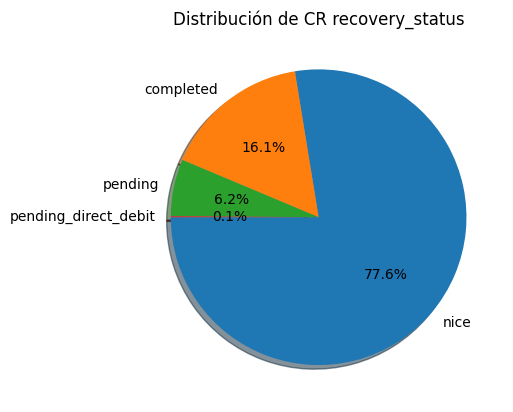

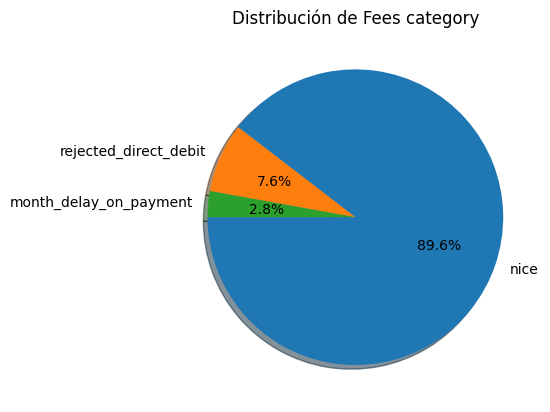

In [9]:
c = 'recovery_status'
p = df_jo['recovery_status'].value_counts().nlargest(4) # .sum().nlargest(8)   #df_cp[df_cp['region'].isin(region_largest)]
p.plot.pie(title= f"Distribución de {c}", legend=False, \
                   autopct='%1.1f%%', \
                   shadow=True, startangle=180)
plt.ylabel("") #plt.legend(loc='best'); plt.grid(True) # figsize=(12,6)
plt.title(f"Distribución de CR {c}")
plt.show()

c = 'category'
p = df_jo['category'].value_counts() #.nlargest(4) # .sum().nlargest(8)   #df_cp[df_cp['region'].isin(region_largest)]
p.plot.pie(title= f"Distribución de {c}", legend=False, \
                   autopct='%1.1f%%', \
                   shadow=True, startangle=180)
plt.ylabel("") #plt.legend(loc='best'); plt.grid(True) # figsize=(12,6)
plt.title(f"Distribución de Fees {c}")
plt.show()

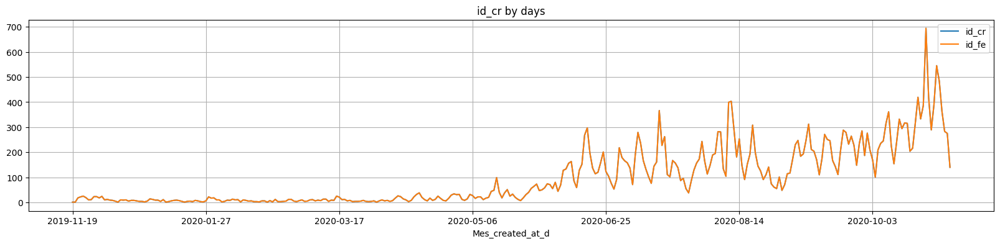

In [10]:
df_t = pm.df('df_jo')
df_t['Mes_created_at_d'] = df_t['created_at'].dt.to_period('d').astype(str)
df_t['Mes_created_at_w'] = df_t['created_at'].dt.to_period('W-WED').astype(str)
df_t['Mes_created_at_m'] = df_t['created_at'].dt.to_period('M').astype(str)
#df_jo.info()

#resultat = set.groupby(0)['index'].unique()
#fields = [v[0] for k, v in resultat.items()]
fields = ['id_cr','id_fe']

fig, ax= plt.subplots(figsize=(20,4))
plt.title('id_cr by days')
ratio_bag=df_t.groupby('Mes_created_at_d')[fields].count()
ratio_bag.plot(kind='line', ax=ax ) # ,color=['green', 'orange']
plt.grid()
plt.show()

#### Examinar casos de clientes concretos

* vips: 12934, 526
    * 90 Este se esta gestionando mal: todos instant, con demoras y sin gestion por 
    * 1946 Parece un ejemplo de buena gestion, al final tiene un instant y se le ha dado margen el las demoras.
    * 1987 Parece un ejemplo de buen usuario, se pasa a instant para siempre.

In [11]:
df = pm.df('df_jo')

cr_id = ['id_cr','id_fe','user_id', 'created_at','created_at_fe','amount','fee','stat_cr','stat_fe','transfer_type','type',
            'to_receive_ini', 'to_receive_bank','to_reimbur','to_reimbur_cash','to_end','to_send',
             'send_at', 'cr_received_date', 'money_back_date', 'reimbursement_date',
            'paid_at','charge_moment','moderated_at','reason','category','from_date','to_date', 'recovery_status'] # ,'id_y','from_date','to_date','reason','recovery_status', 'cash_request_id'

print("Casos segun Cash Request ID")
pd.options.display.max_columns = None
for id in ([23534]): # 16391 20108, 20104, 20112,
    df_t = df[df['id_cr'] == id].reset_index()
    print(f"Cash Request ID: {id}")
    display(df_t[cr_id].sort_values('created_at'))

user_ids = [21465] #[2002] #, 1987, 1946, 90, 526, 12934] #, 12274 54879 12441, 13851, 16391, 430,  63894,18730,10116,21465, 99000262]
# vips 12934 526
# 90 Este se esta gestionando mal: todos instant, con demoras y sin gestion por 
# 1946 Parece un ejemplo de buena gestion, al final tiene un instant y se le ha dado margen el las demoras.
# 1987 Parece un ejemplo de buen usuario, se pasa a instant para siempre.

pd.options.display.max_columns = None
print("Casos segun Cash User ID")
for id in (user_ids):
    #df_t = df[df['user_id'] == id].reset_index()
    df_t = df[(df['user_id'] == id) & (df['stat_cr'] == 'money_back')].reset_index()
    print(f"User ID: {id}")
    display(df_t[cr_id].sort_values('created_at').reset_index())

Casos segun Cash Request ID
Cash Request ID: 23534


,id_cr,id_fe,user_id,created_at,created_at_fe,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,money_back_date,reimbursement_date,paid_at,charge_moment,moderated_at,reason,category,from_date,to_date,recovery_status
0,23534,16460,21465,2020-10-23 15:20:26.163927,2020-10-23 15:21:35.895711,25.0,5.0,money_back,accepted,instant,instant_payment,3 days 00:01:00.714598,3 days,18 days 08:30:33.836073,18 days 08:29:33.121475,4 days 16:34:38.154521,0 days 00:01:00.714598,2020-10-23 15:21:26.878525,2020-10-26 15:21:26.878525,2020-11-06 07:16:21.845479,2020-11-10 23:51:00,2020-11-06 07:16:22.014422,after,NaT,Instant Payment Cash Request 23534,nice,NaT,NaT,nice


Casos segun Cash User ID
User ID: 21465


,index,id_cr,id_fe,user_id,created_at,created_at_fe,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,money_back_date,reimbursement_date,paid_at,charge_moment,moderated_at,reason,category,from_date,to_date,recovery_status
0,0,23534,16460,21465,2020-10-23 15:20:26.163927,2020-10-23 15:21:35.895711,25.0,5.0,money_back,accepted,instant,instant_payment,3 days 00:01:00.714598,3 days,18 days 08:30:33.836073,18 days 08:29:33.121475,4 days 16:34:38.154521,0 days 00:01:00.714598,2020-10-23 15:21:26.878525,2020-10-26 15:21:26.878525,2020-11-06 07:16:21.845479,2020-11-10 23:51:00,2020-11-06 07:16:22.014422,after,NaT,Instant Payment Cash Request 23534,nice,NaT,NaT,nice


#### Calcular la medias:

* 2,94 dias de demora promedio en las transferencias bancarias
* 31.6: Promedio del tiempo que tarda la empresa en cobrar los fee

In [12]:
pd.options.display.max_columns = None
df = pm.df('df_jo')
# Calcular la medias:

# 2,94 dias de demora promedio en las transferencias bancarias
print(df['to_receive_bank'].dt.days.mean())
#x = df['to_b2b_delay'] = (df.cr_received_date-df.send_at).dt.days
#display(x.notna().mean())
#display(df['to_b2b_delay'])# .mean()

# 31.6: Promedio del tiempo que tarda la empresa en cobrar los fee
df['to_fee_paid_delay'] = (df.paid_at -df.created_at).dt.days
x =  df[(df['to_fee_paid_delay'].notna()) & (df['stat_cr'] == 'money_back')]
display(x.to_fee_paid_delay.mean())


-2.5572200524316515


np.float64(31.65246496060247)

#### Identificar datos erroneos e incorporarlos en la libreria:

In [13]:
pd.options.display.max_columns = None
df = pm.df('df_jo')

# send_at mirar si tiene registros faltantes.
# money_back_date

#0 registros
#display(df[ (df['reimbursement_date'].isna()) & (df['stat_cr'] == 'money_back') ])


#191 registros
#display(df[ ((df['reimbursement_date'].isna()) | (df['money_back_date'].isna())) & (df['stat_cr'] == 'money_back') ])

#191 Normalizamos:
display(df[ (df['money_back_date'].isna()) & (df['stat_cr'] == 'money_back') ])
df['money_back_date'] = df.apply(
            lambda row: row['reimbursement_date']             
            if ( pd.isna(row['money_back_date']) & (row['stat_cr'] == 'money_back') ) 
            else row['money_back_date'], axis=1)
display(df[ (df['money_back_date'].isna()) & (df['stat_cr'] == 'money_back') ])

# 838  registros
#display(df[ (df['reimbursement_date'].notna()) & (df['money_back_date'].notna() & (df['stat_cr'] != 'money_back') )])#.head(5).reset_index()

,id_cr,id_fe,fe_cr_id,user_id,active,created_at,created_at_fe,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,money_back_date,reimbursement_date,paid_at,charge_moment,moderated_at,reason,category,from_date,to_date,recovery_status,updated_at,reco_creation,reco_last_update,updated_at_fe,Mes_created_at,cash_request_received_date,created_at_slot,created_at_dow,needs_m_check_recov,n_fees,n_backs,n_inc_back,n_inc_fees,n_recovery,created_at_w,n_cr_fe_w,created_at_m,n_cr_fe_m,created_at_y,n_cr_fe_y,created_at_d,GBP_EUR,BTC_GBP,inflation,unemploy_rate


,id_cr,id_fe,fe_cr_id,user_id,active,created_at,created_at_fe,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,money_back_date,reimbursement_date,paid_at,charge_moment,moderated_at,reason,category,from_date,to_date,recovery_status,updated_at,reco_creation,reco_last_update,updated_at_fe,Mes_created_at,cash_request_received_date,created_at_slot,created_at_dow,needs_m_check_recov,n_fees,n_backs,n_inc_back,n_inc_fees,n_recovery,created_at_w,n_cr_fe_w,created_at_m,n_cr_fe_m,created_at_y,n_cr_fe_y,created_at_d,GBP_EUR,BTC_GBP,inflation,unemploy_rate


In [14]:
pd.options.display.max_columns = None
df = pm.df('df_jo')

# Normalizamos
# 1219 estos los ponemos a +3 dias (promedio 2,94 dias)
# cr_received_date a 'send_at' +3 dias
display(df[ (df['send_at'].notna()) & (df['cr_received_date'].isna() & (df['stat_cr'] == 'money_back') )])#.head(5).reset_index()
df['cr_received_date'] = df.apply(
            lambda row: row['send_at']+ pd.DateOffset(days=3) 
            if ( pd.isna(row['cr_received_date']) & (row['stat_cr'] == 'money_back') ) 
            else row['cr_received_date'], axis=1
        )
display(df[ (df['send_at'].notna()) & (df['cr_received_date'].isna() & (df['stat_cr'] == 'money_back') )])#.head(5).reset_index()

# 5960 estos los ponemos a -3 dias (promedio 2,94 dias)
#display(df[ (df['send_at'].isna()) & (df['cr_received_date'].notna() & (df['stat_cr'] == 'money_back') )])#.head(5).reset_index()

# 8177 Casos
#display(df[ (df['reimbursement_date'].isna()) | (df['money_back_date'].isna())  ])#.head(5).reset_index()

# Casos a interpolar:
#ratio_bag=df.groupby('Mes_created_at_d')[['amount', 'fee']].mean()
#display(ratio_bag)

# df['reimbursement_date'] = df.apply(
#             lambda row: row['money_back_date'] if not pd.isna(row['money_back_date']) else row['reimbursement_date'], axis=1
#         )

,id_cr,id_fe,fe_cr_id,user_id,active,created_at,created_at_fe,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,money_back_date,reimbursement_date,paid_at,charge_moment,moderated_at,reason,category,from_date,to_date,recovery_status,updated_at,reco_creation,reco_last_update,updated_at_fe,Mes_created_at,cash_request_received_date,created_at_slot,created_at_dow,needs_m_check_recov,n_fees,n_backs,n_inc_back,n_inc_fees,n_recovery,created_at_w,n_cr_fe_w,created_at_m,n_cr_fe_m,created_at_y,n_cr_fe_y,created_at_d,GBP_EUR,BTC_GBP,inflation,unemploy_rate


,id_cr,id_fe,fe_cr_id,user_id,active,created_at,created_at_fe,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,money_back_date,reimbursement_date,paid_at,charge_moment,moderated_at,reason,category,from_date,to_date,recovery_status,updated_at,reco_creation,reco_last_update,updated_at_fe,Mes_created_at,cash_request_received_date,created_at_slot,created_at_dow,needs_m_check_recov,n_fees,n_backs,n_inc_back,n_inc_fees,n_recovery,created_at_w,n_cr_fe_w,created_at_m,n_cr_fe_m,created_at_y,n_cr_fe_y,created_at_d,GBP_EUR,BTC_GBP,inflation,unemploy_rate


### Segmentacion

### Clientes respecto a han sido moderados

In [15]:
df_jo = pm.df('df_jo')
df_jo = pm.sort("df_jo", ['created_at','created_at_fe']).reset_index()
df_jo = df_jo.drop(columns=['index'])

pd.options.display.max_columns = None

fields = ['id_cr','user_id','created_at','moderated_at','to_reimbur','transfer_type','stat_cr' ,'amount','fee',
          'n_fees','n_backs','needs_m_check_recov', 'n_recovery','n_inc_back','n_inc_fees',
          'n_cr_fe_w','n_cr_fe_m',  #'created_at_dow',
          'stat_fe','id_fe','created_at_fe','updated_at_fe','reason','money_back_date', 'reimbursement_date',
          'to_reimbur','from_date','to_date', 'charge_moment','type','recovery_status','created_at_slot' 
          ]

df = df_jo.copy()
df['created_at'] = pd.to_datetime(df['created_at'])
df = df.sort_values(by=['user_id', 'created_at'])

# obtenemos la primera fila de cada 'user_id' (la más antigua)
primer_registro = df.groupby('user_id').first()
primer_registro['no_moderat'] = primer_registro['moderated_at'].isnull()
no_moderats = primer_registro.reset_index() #level='user_id')
no_moderats = primer_registro[primer_registro['no_moderat'] == True]
resultat = no_moderats[no_moderats.transfer_type.isin(['regular','instant'])].reset_index()

print(f"Usuarios nuevos: {resultat.user_id.count()}")

df['moderada'] = df['moderated_at'].apply(lambda x: 1 if not pd.isnull(x) else 0)
cnt = df[df['moderada'] == 1]
print(f"moderados: {cnt.moderada.count()}")

cnt = df[df['moderada'] == 0]
print(f"no moderados: {cnt.moderada.count()}")

Usuarios nuevos: 5027
moderados: 21757
no moderados: 10335


In [16]:
## Ejemplo para user_id 47
display(df[df['user_id'] == 47].sort_values('created_at')[fields].reset_index())

,index,id_cr,user_id,created_at,moderated_at,to_reimbur,transfer_type,stat_cr,amount,fee,n_fees,n_backs,needs_m_check_recov,n_recovery,n_inc_back,n_inc_fees,n_cr_fe_w,n_cr_fe_m,stat_fe,id_fe,created_at_fe,updated_at_fe,reason,money_back_date,reimbursement_date,to_reimbur,from_date,to_date,charge_moment,type,recovery_status,created_at_slot
0,0,3,47,2019-11-19 13:57:53.511561,2019-11-20 12:16:50.000000,16 days 09:02:06.488439,regular,canceled,1.0,0.0,0,0,1,0,1,0,0,0,cr_regular,0,NaT,NaT,NaN,NaT,2019-12-05 23:00:00.000000,16 days 09:02:06.488439,NaT,NaT,NaN,0,nice,13
1,53,118,47,2019-12-12 14:14:14.131479,2019-12-12 14:41:39.485394,6 days 23:59:59.999546,regular,rejected,100.0,0.0,0,0,1,0,2,0,0,0,cr_regular,0,NaT,NaT,NaN,NaT,2019-12-19 14:14:14.131025,6 days 23:59:59.999546,NaT,NaT,NaN,0,nice,14
2,1143,1218,47,2020-04-16 08:42:15.429083,2020-04-16 09:15:24.585050,14 days 00:00:00.577917,regular,money_back,100.0,0.0,0,1,0,0,2,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-05-08 21:35:33.858794,2020-04-30 08:42:16.007000,14 days 00:00:00.577917,NaT,NaT,NaN,0,nice,8
3,1771,1832,47,2020-05-15 16:04:10.449840,2020-05-15 16:08:34.000000,125 days 05:55:49.550160,regular,money_back,10.0,5.0,0,2,1,0,2,1,1,1,cancelled,72,2020-05-29 14:27:56.118917,2020-12-22 17:19:26.530567,Postpone Cash Request 1832,2020-08-04 18:19:04.558434,2020-09-17 22:00:00.000000,125 days 05:55:49.550160,2020-07-19 22:00:00,2020-08-03 22:00:00,before,postpone,nice,16
4,1772,1832,47,2020-05-15 16:04:10.449840,2020-05-15 16:08:34.000000,125 days 05:55:49.550160,regular,money_back,10.0,5.0,0,2,1,0,2,2,1,1,cancelled,71,2020-05-29 14:27:56.118917,2020-12-22 17:19:34.028812,Postpone Cash Request 1832,2020-08-04 18:19:04.558434,2020-09-17 22:00:00.000000,125 days 05:55:49.550160,2020-06-19 22:00:00,2020-07-19 22:00:00,before,postpone,nice,16
5,1773,1832,47,2020-05-15 16:04:10.449840,2020-05-15 16:08:34.000000,125 days 05:55:49.550160,regular,money_back,10.0,5.0,0,2,1,0,2,3,1,1,cancelled,47,2020-06-01 14:24:14.624776,2020-12-22 17:19:20.056527,Postpone Cash Request 1832,2020-08-04 18:19:04.558434,2020-09-17 22:00:00.000000,125 days 05:55:49.550160,2020-08-03 22:00:00,2020-08-18 22:00:00,before,postpone,nice,16
6,1774,1832,47,2020-05-15 16:04:10.449840,2020-05-15 16:08:34.000000,125 days 05:55:49.550160,regular,money_back,10.0,5.0,0,2,1,0,2,4,1,1,cancelled,21,2020-06-23 08:20:48.513423,2020-12-22 17:19:13.611324,Postpone Cash Request 1832,2020-08-04 18:19:04.558434,2020-09-17 22:00:00.000000,125 days 05:55:49.550160,2020-06-05 22:00:00,2020-06-19 22:00:00,before,postpone,nice,16
7,1775,1832,47,2020-05-15 16:04:10.449840,2020-05-15 16:08:34.000000,125 days 05:55:49.550160,regular,money_back,10.0,5.0,1,2,0,0,2,4,1,1,accepted,1367,2020-07-14 14:59:45.303324,2020-10-13 14:25:02.353414,Postpone Cash Request 1832,2020-08-04 18:19:04.558434,2020-09-17 22:00:00.000000,125 days 05:55:49.550160,2020-08-18 22:00:00,2020-09-17 22:00:00,before,postpone,nice,16
8,11530,10942,47,2020-08-05 09:34:16.818322,2020-08-05 09:35:50.000000,55 days 12:25:43.181678,instant,money_back,10.0,5.0,2,3,0,0,2,4,2,2,accepted,2792,2020-08-05 09:35:51.945346,2021-01-21 15:50:35.089962,Instant Payment Cash Request 10942,2020-09-22 15:05:36.000000,2020-09-29 22:00:00.000000,55 days 12:25:43.181678,NaT,NaT,after,instant_payment,nice,9
9,11531,10942,47,2020-08-05 09:34:16.818322,2020-08-05 09:35:50.000000,55 days 12:25:43.181678,instant,money_back,10.0,5.0,3,3,0,0,2,4,2,2,accepted,5609,2020-09-01 10:54:11.067922,2020-10-13 14:25:08.138501,Postpone Cash Request 10942,2020-09-22 15:05:36.000000,2020-09-29 22:00:00.000000,55 days 12:25:43.181678,2020-09-04 22:00:00,2020-09-29 22:00:00,before,postpone,nice,9


### Detalle clientes por frecuencia en operaciones exitosas

In [17]:
import pandas as pd
import payments_manager as pm
df_jo = pm.df('df_jo')
df_jo = pm.sort("df_jo", ['created_at','created_at_fe']).reset_index()
df_jo = df_jo.drop(columns=['index'])
pd.options.display.max_columns = None
fields = ['id_cr','user_id','created_at','moderated_at','to_reimbur','transfer_type','stat_cr' ,'amount','fee',
          'n_fees','n_backs','needs_m_check_recov', 'n_recovery','n_inc_back','n_inc_fees',
          'n_cr_fe_w','n_cr_fe_m',  #'created_at_dow',
          'stat_fe','id_fe','created_at_fe','updated_at_fe','reason','money_back_date', 'reimbursement_date',
          'to_reimbur','from_date','to_date', 'charge_moment','type','recovery_status','created_at_slot' 
          # 'paid_at', 'to_end',, #,'user_id', 'cr_received_date','recovery_status'
          ]
pm.format_to_dates(df_jo, time_format='d') # 'min','s'
df_jo = df_jo.sort_values(by=['user_id', 'created_at','created_at_fe'])
display(df_jo[df_jo.user_id == 2002  ][fields].reset_index(drop=True)) ## 34 47 2002

,id_cr,user_id,created_at,moderated_at,to_reimbur,transfer_type,stat_cr,amount,fee,n_fees,n_backs,needs_m_check_recov,n_recovery,n_inc_back,n_inc_fees,n_cr_fe_w,n_cr_fe_m,stat_fe,id_fe,created_at_fe,updated_at_fe,reason,money_back_date,reimbursement_date,to_reimbur,from_date,to_date,charge_moment,type,recovery_status,created_at_slot
0,423,2002,2020-01-10,2020-01-10,27 days 12:04:39.242861,regular,money_back,100.0,0.0,0,1,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-02-06,2020-02-06,27 days 12:04:39.242861,NaT,NaT,NaN,0,nice,10
1,697,2002,2020-02-18,2020-02-19,9 days 06:23:08.750963,regular,money_back,100.0,0.0,0,2,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-02-27,2020-02-27,9 days 06:23:08.750963,NaT,NaT,NaN,0,nice,16
2,835,2002,2020-03-10,2020-03-10,26 days 14:12:20.662959,regular,money_back,100.0,0.0,0,3,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-04-14,2020-04-05,26 days 14:12:20.662959,NaT,NaT,NaN,0,nice,7
3,1172,2002,2020-04-14,2020-04-15,21 days 00:56:50.480674,regular,money_back,100.0,0.0,0,4,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-05-14,2020-05-05,21 days 00:56:50.480674,NaT,NaT,NaN,0,nice,21
4,1800,2002,2020-05-15,2020-05-15,22 days 17:50:08.908111,regular,money_back,100.0,0.0,0,5,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-06-10,2020-06-06,22 days 17:50:08.908111,NaT,NaT,NaN,0,nice,4
5,2949,2002,2020-06-10,2020-06-11,25 days 22:25:46.443499,regular,money_back,100.0,0.0,0,6,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-07-07,2020-07-06,25 days 22:25:46.443499,NaT,NaT,NaN,0,nice,23
6,8177,2002,2020-07-15,2020-07-17,20 days 12:16:36.825715,regular,money_back,100.0,5.0,0,7,1,0,0,1,3,3,cancelled,1674,2020-07-20,2020-10-13,Postpone Cash Request 8177,2020-08-03,2020-08-05,20 days 12:16:36.825715,2020-08-04,2020-08-19,after,postpone,nice,13
7,8177,2002,2020-07-15,2020-07-17,20 days 12:16:36.825715,regular,money_back,100.0,5.0,1,7,0,0,0,1,3,3,accepted,1749,2020-07-22,2020-10-13,Postpone Cash Request 8177,2020-08-03,2020-08-05,20 days 12:16:36.825715,2020-08-04,2020-08-15,before,postpone,nice,13
8,8177,2002,2020-07-15,2020-07-17,20 days 12:16:36.825715,regular,money_back,100.0,5.0,2,7,0,0,0,1,3,3,accepted,1839,2020-07-23,2020-10-13,Postpone Cash Request 8177,2020-08-03,2020-08-05,20 days 12:16:36.825715,2020-08-15,2020-08-30,before,postpone,nice,13
9,8177,2002,2020-07-15,2020-07-17,20 days 12:16:36.825715,regular,money_back,100.0,5.0,3,7,0,0,0,1,3,3,accepted,1977,2020-07-25,2020-10-13,Postpone Cash Request 8177,2020-08-03,2020-08-05,20 days 12:16:36.825715,2020-08-30,2020-09-14,before,postpone,nice,13


#### Por ID de Cash Request

,id_cr,id_fe,fe_cr_id,user_id,active,created_at,created_at_fe,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,money_back_date,reimbursement_date,paid_at,charge_moment,moderated_at,reason,category,from_date,to_date,recovery_status,updated_at,reco_creation,reco_last_update,updated_at_fe,Mes_created_at,cash_request_received_date,created_at_slot,created_at_dow,needs_m_check_recov,n_fees,n_backs,n_inc_back,n_inc_fees,n_recovery,created_at_w,n_cr_fe_w,created_at_m,n_cr_fe_m,created_at_y,n_cr_fe_y,created_at_d,GBP_EUR,BTC_GBP,inflation,unemploy_rate
0,3,0,NaN,47,1,2019-11-19 13:57:53.511561,NaT,1.0,0.0,canceled,cr_regular,regular,0,NaT,NaT,16 days 09:02:06.488439,NaT,NaT,NaT,NaT,NaT,NaT,2019-12-05 23:00:00.000000,NaT,NaN,2019-11-20 12:16:50.000000,NaN,NaN,NaT,NaT,nice,2020-12-14 10:25:57.710844,NaT,NaT,NaT,2019-11,NaT,13,1,1,0,0,1,0,0,47,0,11,0,2019,0,2019-11-19,1.16935,6347.577148,1.3,3.9
1,4,0,NaN,99001309,0,2019-12-09 14:47:35.190714,NaT,100.0,0.0,money_back,cr_regular,regular,0,NaT,NaT,7 days 08:12:24.809286,NaT,0 days 00:00:00,NaT,NaT,NaT,2019-12-16 23:00:00.000000,2019-12-16 23:00:00.000000,NaT,NaN,2019-12-09 14:58:28.000000,NaN,NaN,NaT,NaT,nice,2020-11-04 12:54:52.120014,NaT,NaT,NaT,2019-12,NaT,14,0,0,0,1,0,0,0,50,1,12,1,2019,1,2019-12-09,1.18803,5630.115723,1.3,4.0
2,5,0,NaN,804,1,2019-12-10 19:05:21.596873,NaT,100.0,0.0,rejected,cr_regular,regular,0,NaT,NaT,29 days 23:59:59.999490,NaT,NaT,NaT,NaT,NaT,NaT,2020-01-09 19:05:21.596363,NaT,NaN,2019-12-11 16:47:42.405646,NaN,NaN,NaT,NaT,nice,2019-12-11 16:47:42.407830,NaT,NaT,NaT,2019-12,NaT,19,1,1,0,0,1,0,0,50,0,12,0,2019,0,2019-12-10,1.18800,5543.707520,1.3,4.0
3,6,0,NaN,812,1,2019-12-10 19:05:48.921042,NaT,100.0,0.0,direct_debit_rejected,cr_regular,regular,0,0 days 04:54:11.078958,NaT,57 days 03:54:11.078958,NaT,NaT,NaT,NaT,2019-12-11 00:00:00.000000,NaT,2020-02-05 23:00:00.000000,NaT,NaN,2019-12-11 09:40:33.000000,NaN,NaN,NaT,NaT,pending,2020-12-18 22:47:47.993817,2020-03-20 14:12:53.208246,2020-12-18 22:47:48.008850,NaT,2019-12,2019-12-11 00:00:00.000000,19,1,1,0,0,1,0,1,50,0,12,0,2019,0,2019-12-10,1.18800,5543.707520,1.3,4.0
4,7,0,NaN,191,1,2019-12-10 19:13:35.825460,NaT,100.0,0.0,rejected,cr_regular,regular,0,NaT,NaT,29 days 23:59:59.999581,NaT,NaT,NaT,NaT,NaT,NaT,2020-01-09 19:13:35.825041,NaT,NaN,2019-12-11 09:46:59.777728,NaN,NaN,NaT,NaT,nice,2019-12-11 09:46:59.779773,NaT,NaT,NaT,2019-12,NaT,19,1,1,0,0,1,0,0,50,0,12,0,2019,0,2019-12-10,1.18800,5543.707520,1.3,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32087,27006,21181,27006.0,55916,1,2020-11-01 23:07:55.231487,2020-11-01 23:08:17.050811,50.0,5.0,money_back,accepted,instant,instant_payment,0 days 00:52:04.768513,0 days 00:51:52.585840,10 days 22:52:04.768513,10 days 22:51:52.585840,0 days 02:20:39.758020,0 days 00:00:12.182673,2020-11-01 23:08:07.414160,2020-11-02 00:00:00.000000,2020-11-12 19:39:20.241980,2020-11-12 22:00:00.000000,2020-11-12 19:39:20.299302,after,NaT,Instant Payment Cash Request 27006,nice,NaT,NaT,nice,2020-12-18 13:11:35.051472,NaT,NaT,2020-11-01 23:08:17.050835,2020-11,2020-11-02 00:00:00.000000,23,6,0,2,2,1,0,0,44,1,11,1,2020,2,2020-11-01,0.00000,10627.522461,0.7,5.3
32088,27007,21182,27007.0,39339,1,2020-11-01 23:11:37.788849,2020-11-01 23:12:30.916635,100.0,5.0,money_back,accepted,instant,instant_payment,0 days 00:48:22.211151,0 days 00:47:43.664084,27 days 11:48:22.211151,27 days 11:47:43.664084,-1 days +15:32:16.944702,0 days 00:00:38.547067,2020-11-01 23:12:16.335916,2020-11-02 00:00:00.000000,2020-11-29 19:27:43.055298,2020-11-29 11:00:00.000000,2020-11-29 19:27:43.101686,after,NaT,Instant Payment Cash Request 27007,nice,NaT,NaT,nice,2020-12-18 13:13:10.258884,NaT,NaT,2020-11-01 23:12:30.916658,2020-11,2020-11-02

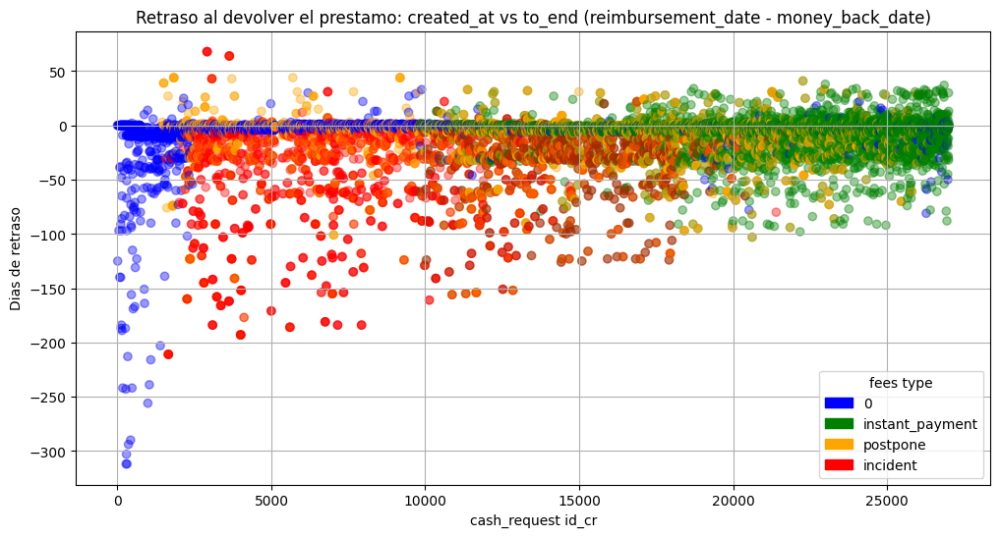

In [18]:
df = pm.df('df_jo')
display(df)
classification_colors = {0: 'blue', 'instant_payment':'green', 'postpone':'orange', 'incident':'red'}
#df['created_at_w'] = df['created_at']# .dt.to_period('W').astype(str)
df= df.dropna(subset=['to_end'])
#df= df.dropna(subset=['type'])
x_values = df['id_cr']
y_values = df['to_end'].dt.days # .astype('int')
c_values= list(df['type'].map(classification_colors))
fig, ax= plt.subplots(figsize=(12,6))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = .4)
plt.title('Retraso al devolver el prestamo: created_at vs to_end (reimbursement_date - money_back_date)')
plt.xlabel('cash_request id_cr')
plt.ylabel('Dias de retraso')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

#### Por fecha creacion de registro de Cash Request

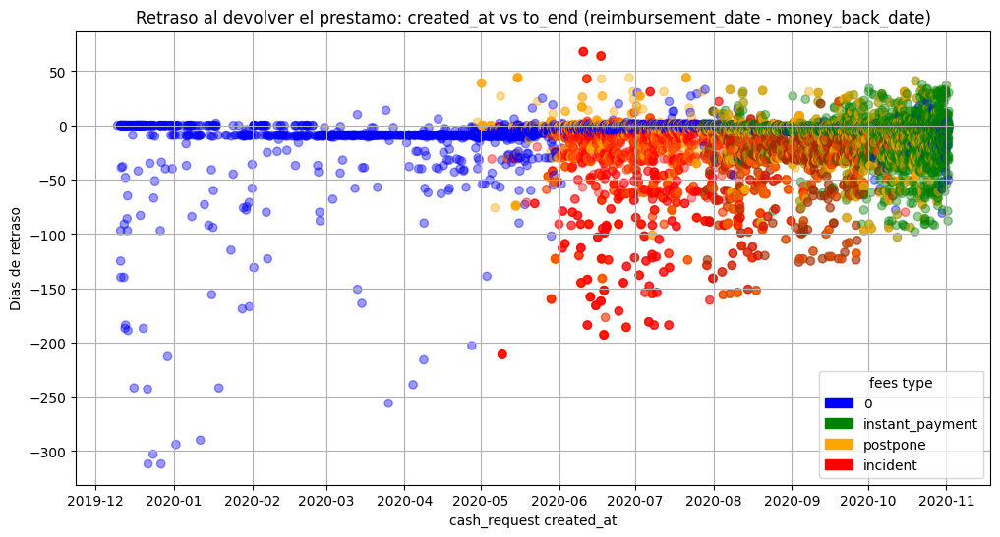

In [19]:
df = pm.df('df_jo')
classification_colors = {0: 'blue', 'instant_payment':'green', 'postpone':'orange', 'incident':'red'}
#df['created_at_w'] = df['created_at']# .dt.to_period('W').astype(str)
df= df.dropna(subset=['to_end'])
#df= df.dropna(subset=['type'])
x_values = df['created_at'] #'id_cr']
y_values = df['to_end'].dt.days # .astype('int')
c_values= list(df['type'].map(classification_colors))
fig, ax= plt.subplots(figsize=(12,6))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = .4)
plt.title('Retraso al devolver el prestamo: created_at vs to_end (reimbursement_date - money_back_date)')
plt.xlabel('cash_request created_at')
plt.ylabel('Dias de retraso')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

#### Por fecha creacion de registro de Cash Request (Escala logaritmica)

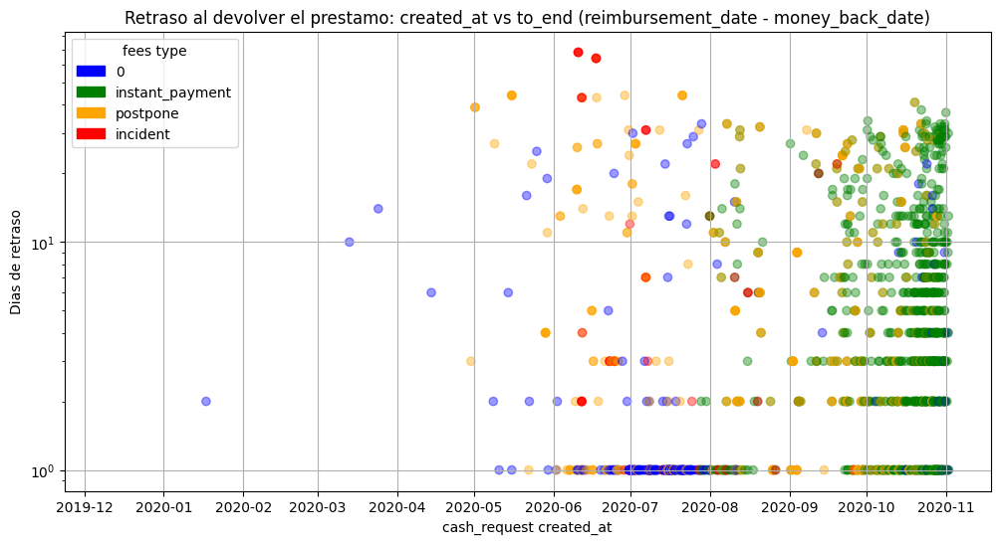

In [20]:
df = pm.df('df_jo')
classification_colors = {0: 'blue', 'instant_payment':'green', 'postpone':'orange', 'incident':'red'}
#df['created_at_w'] = df['created_at']# .dt.to_period('W').astype(str)
df= df.dropna(subset=['to_end'])
#df= df.dropna(subset=['type'])
x_values = df['created_at'] #'id_cr']
y_values = df['to_end'].dt.days # .astype('int')
c_values= list(df['type'].map(classification_colors))
fig, ax= plt.subplots(figsize=(12,6))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = .4)
plt.title('Retraso al devolver el prestamo: created_at vs to_end (reimbursement_date - money_back_date)')
plt.xlabel('cash_request created_at')
plt.ylabel('Dias de retraso')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.yscale('log')
plt.grid()
plt.show()

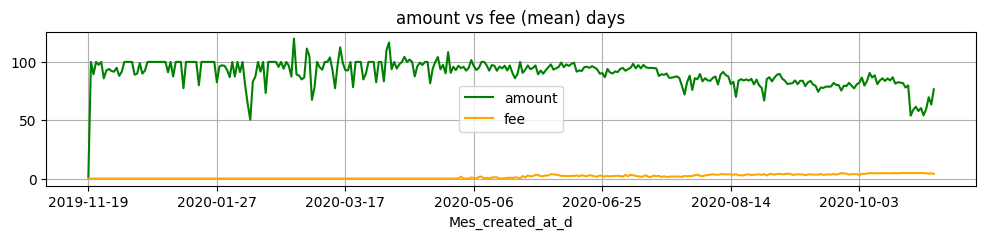

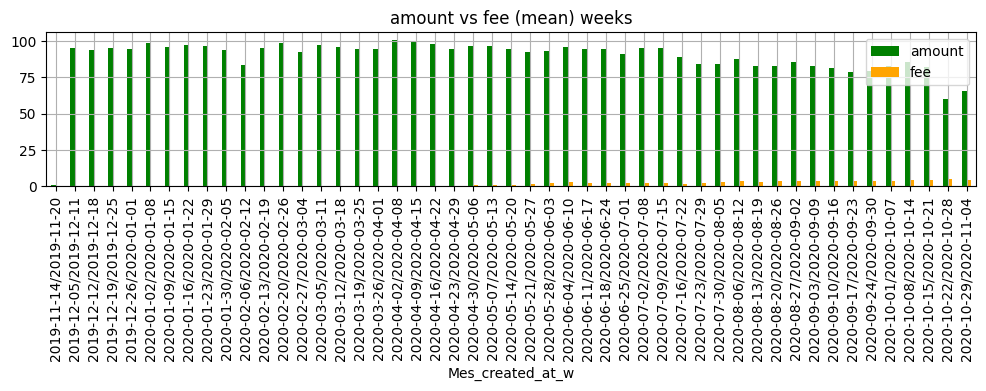

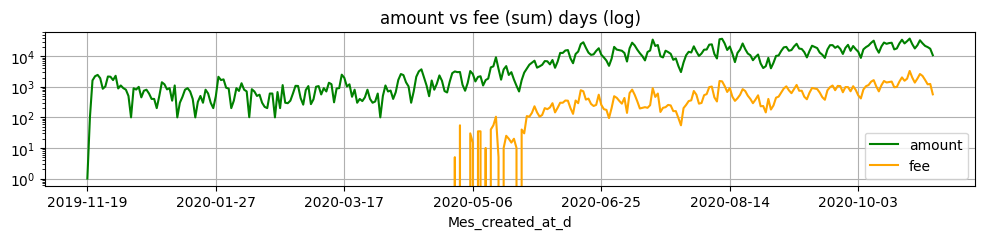

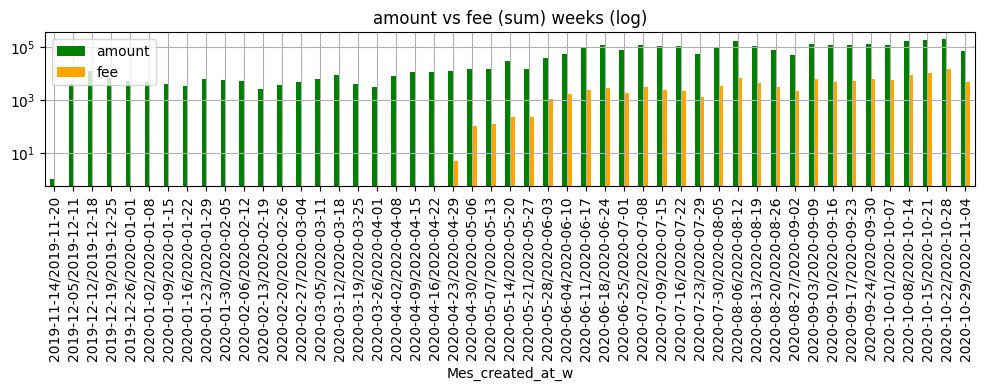

In [21]:
df_t = pm.df('df_jo')
df_t['Mes_created_at_d'] = df_t['created_at'].dt.to_period('d').astype(str)
df_t['Mes_created_at_w'] = df_t['created_at'].dt.to_period('W-WED').astype(str)
df_t['Mes_created_at_m'] = df_t['created_at'].dt.to_period('M').astype(str)

fig, ax= plt.subplots(figsize=(12,2))
plt.title('amount vs fee (mean) days')
ratio_bag=df_t.groupby('Mes_created_at_d')[['amount', 'fee']].mean()
ratio_bag.plot(kind='line', color=['green', 'orange'],ax=ax )
plt.grid()
plt.show()

fig, ax= plt.subplots(figsize=(12,2))
plt.title('amount vs fee (mean) weeks')
ratio_bag=df_t.groupby('Mes_created_at_w')[['amount', 'fee']].mean()
ratio_bag.plot(kind='bar', color=['green', 'orange'],ax=ax )
plt.grid()
plt.show()

fig, ax= plt.subplots(figsize=(12,2))
plt.title('amount vs fee (sum) days (log)')
ratio_bag=df_t.groupby('Mes_created_at_d')[['amount', 'fee']].sum()
ratio_bag.plot(kind='line', color=['green', 'orange'],ax=ax )
plt.yscale('log')
plt.grid()
plt.show()

fig, ax= plt.subplots(figsize=(12,2))
plt.title('amount vs fee (sum) weeks (log)')
ratio_bag=df_t.groupby('Mes_created_at_w')[['amount', 'fee']].sum()
ratio_bag.plot(kind='bar', color=['green', 'orange'],ax=ax )
plt.yscale('log')
plt.grid()
plt.show()

#### Importes de los prestamos

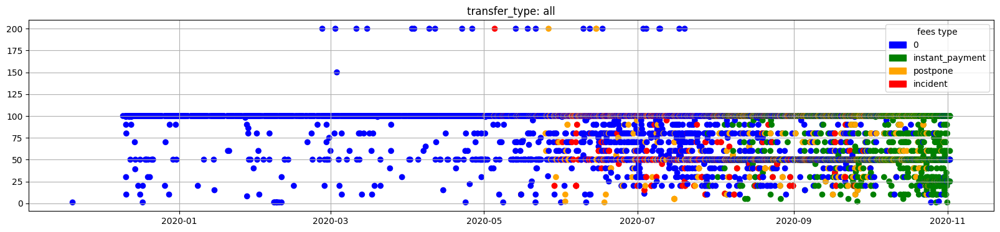

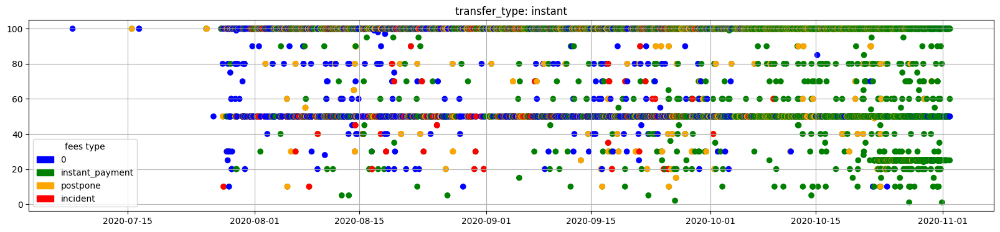

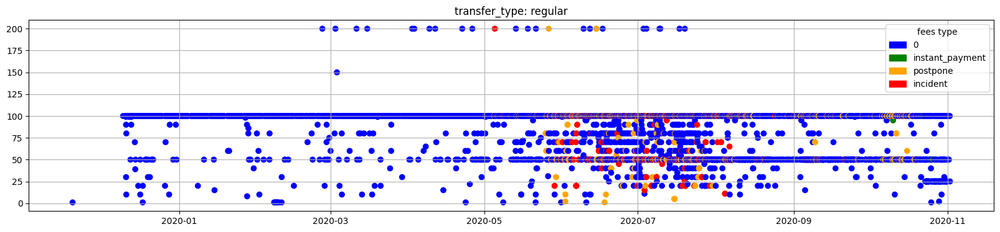

In [22]:
classification_colors = {0: 'blue', 'instant_payment':'green', 'postpone':'orange', 'incident':'red'}
df_t = pm.df('df_jo')
#df_t= df.dropna(subset=['type'])

#df_t['created_at_w'] = df_t['created_at']# .dt.to_period('W').astype(str)
df_filter = df_t
fig, ax= plt.subplots(figsize=(20,4))
x_values = df_filter['created_at']
y_values = df_filter['amount'] # fee
c_values= list(df_filter['type'].map(classification_colors))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = 1.)
plt.title('transfer_type: all')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

df_t['created_at_w'] = df_t['created_at']# .dt.to_period('W').astype(str)
df_filter = df_t[df_t['transfer_type']=='instant']
#display(df_filter)
fig, ax= plt.subplots(figsize=(20,4))
x_values = df_filter['created_at_w']
y_values = df_filter['amount'] # fee
c_values= list(df_filter['type'].map(classification_colors))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = 1.)
plt.title('transfer_type: instant')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

df_t['created_at_w'] = df_t['created_at']# .dt.to_period('W').astype(str)
df_filter = df_t[df_t['transfer_type']=='regular']
#display(df_filter)
fig, ax= plt.subplots(figsize=(20,4))
x_values = df_filter['created_at_w']
y_values = df_filter['amount'] # fee
c_values= list(df_filter['type'].map(classification_colors))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = 1.)
plt.title('transfer_type: regular')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

### Mapas de calor: Cash Request join Fees

In [23]:
#cash_request=pd.read_csv('../data/extract - cash request - data analyst.csv')
#fees=pd.read_csv('../data/extract - fees - data analyst - .csv')
df_jo = pm.df('df_jo')

fig1 = px.imshow(df_jo.isnull(),
color_continuous_scale=['black', 'red'],
labels=dict(color="NaN"),
title="Mapa de calor para cash_request join fees")
fig1.update_layout(width=700, height=700)
fig1.update_coloraxes(showscale=False)
fig1.show()

### Correlaciones

##### Correlaciones descartando columnas auxiliares de fechas

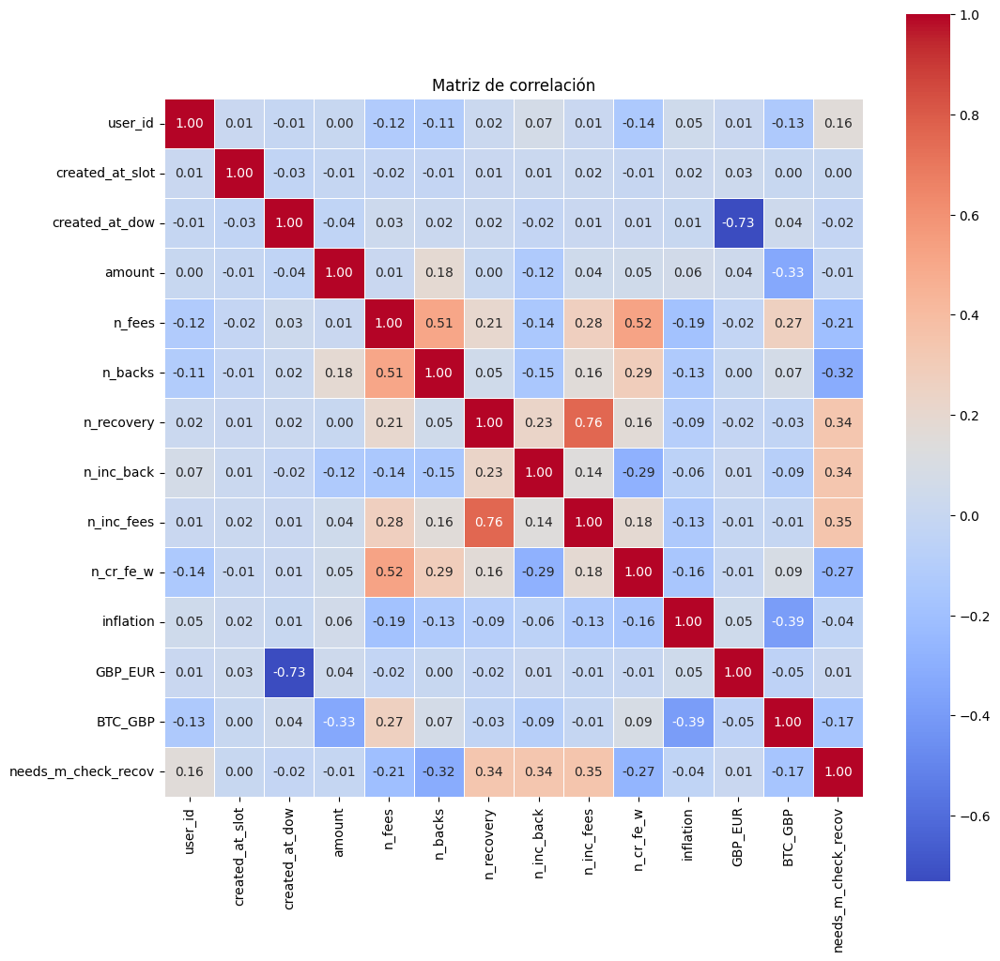

Variables altamente correlacionadas con otras:


[]

In [24]:
df = pm.df('df_hyper')
#df = df.drop(columns=['cash_request_received_date'])

d_list = list(df.select_dtypes(include=['datetime64']).columns)
for date in d_list:
    df[date] = pd.to_datetime(df[date]).dt.strftime('%Y%m%d').astype(float)
df_corr = df.select_dtypes(include=['number'])
matriz_corr = df_corr.corr()
plt.figure(figsize=(12, 12)) 
sns.heatmap(matriz_corr, annot=True, cmap='coolwarm', fmt=".2f", square=True, linewidths=0.5)
plt.title('Matriz de correlación')
plt.show()

# Identificar columnas con correlación alta (umbral = 0.8)
threshold = 0.8
to_drop = []
for column in matriz_corr.columns:
    if any((matriz_corr[column].abs() > threshold) & (matriz_corr.index != column)):
        to_drop.append(column)
print(f"Variables altamente correlacionadas con otras:")
display(to_drop)

### Campos cualitativos a cuantitativos

In [28]:
# Encode labels
label_encoder = preprocessing.LabelEncoder()   

df = pm.df('df_hyper_to') #= pm.df('df_jall')
# df = df.drop(columns=['Mes_created_at'])
# df = df.drop(columns=['fee']) #df = df.drop(columns=['total_amount'])
# df = df.drop(columns=['amount'])
# df = df.drop(columns=['user_id'])
# df = df.drop(columns=['id_fe'])

# df = df.drop(columns=['to_date'])
# df = df.drop(columns=['to_reimbur'])
# df = df.drop(columns=['to_receive_ini'])
# df = df.drop(columns=['to_end'])


# Fechas a formato ISO sin hora
d_list = list(df.select_dtypes(include=['datetime64']).columns)
for date in d_list:
    df[date] = pd.to_datetime(df[date]).dt.strftime('%Y%m%d').astype(float)

# A formato numerico usando la cantidad de registros como codigo
#df['stat_cr_fr'] = df['stat_cr'].map(df['stat_cr'].value_counts())



In [29]:
# # One-hot: true o false
# df_categ = pd.get_dummies(df['transfer_type'], prefix="transfer_type")
# df = pd.concat([df, df_categ], axis=1)

# # A formato numerico usando la cantidad de registros como codigo
# df['recovery_status_fr'] = df['recovery_status'].map(df['recovery_status'].value_counts())
# df['type_fr'] = df['type'].map(df['type'].value_counts())
# df['stat_fe_fr'] = df['stat_fe'].map(df['stat_fe'].value_counts())

# #df['charge_moment_fr'] = df['charge_moment'].map(df['charge_moment'].value_counts())
# #df['category_fr'] = df['category'].map(df['category'].value_counts())

# # One-hot: true o false
# df_categ = pd.get_dummies(df['category'], prefix="category")
# df = pd.concat([df, df_categ], axis=1)

# # One-hot: true o false
# df_categ = pd.get_dummies(df['charge_moment'], prefix="charge_moment")
# df = pd.concat([df, df_categ], axis=1)
# #display(df)

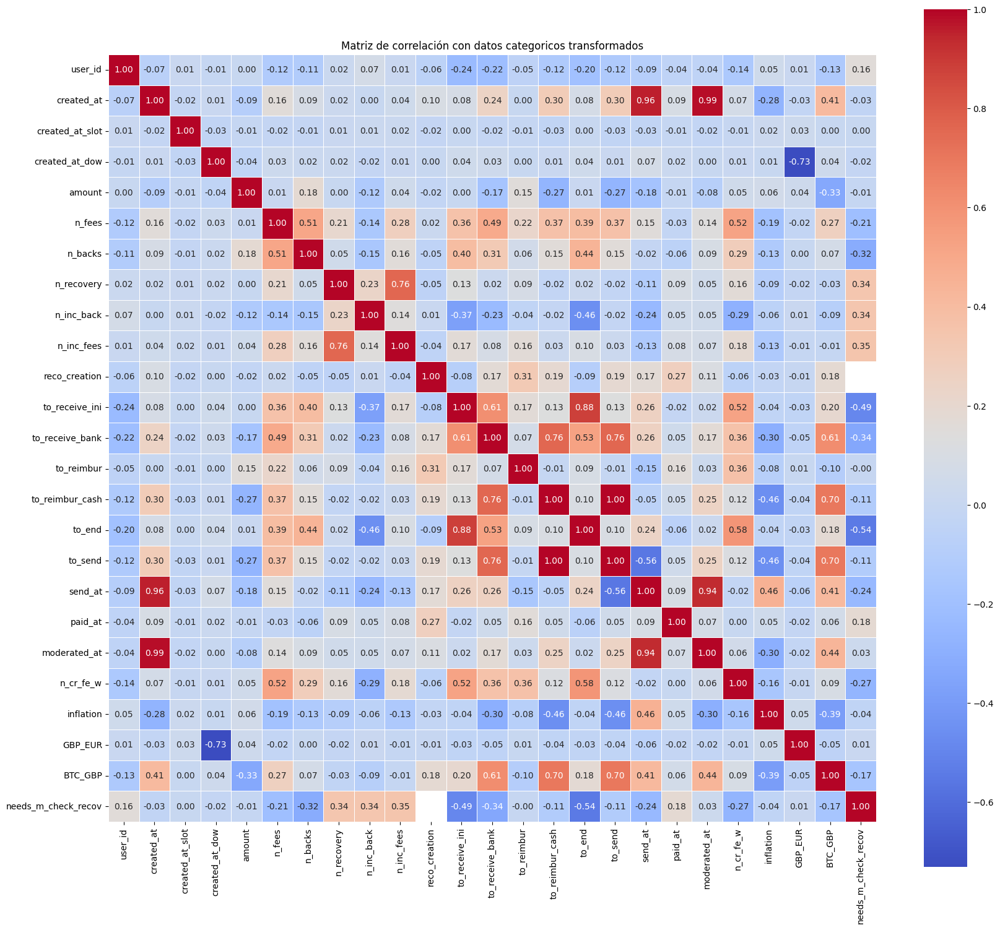

Variables altamente correlacionadas con otras:


['created_at',
 'to_receive_ini',
 'to_reimbur_cash',
 'to_end',
 'to_send',
 'send_at',
 'moderated_at']

In [30]:
df_corr = df.select_dtypes(include=['number'])
df_bool = df.select_dtypes(include=['bool'])
df_corr = pd.concat([df_corr, df_bool], axis=1)

matriz_corr = df_corr.corr()
plt.figure(figsize=(20, 18)) 
sns.heatmap(matriz_corr, annot=True, cmap='coolwarm', fmt=".2f", square=True, linewidths=0.5)
plt.title('Matriz de correlación con datos categoricos transformados')
plt.show()

# Identificar columnas con correlación alta (umbral = 0.8)
threshold = 0.8
to_drop = []
for column in matriz_corr.columns:
    if any((matriz_corr[column].abs() > threshold) & (matriz_corr.index != column)):
        to_drop.append(column)
        
print(f"Variables altamente correlacionadas con otras:")
display(to_drop)

### Analisis de Series Temporales y Ruido asociado

Observaciones:

* Se aprecia un aspecto semanal de los datos al ver la evolucion a lo largo del periodo.

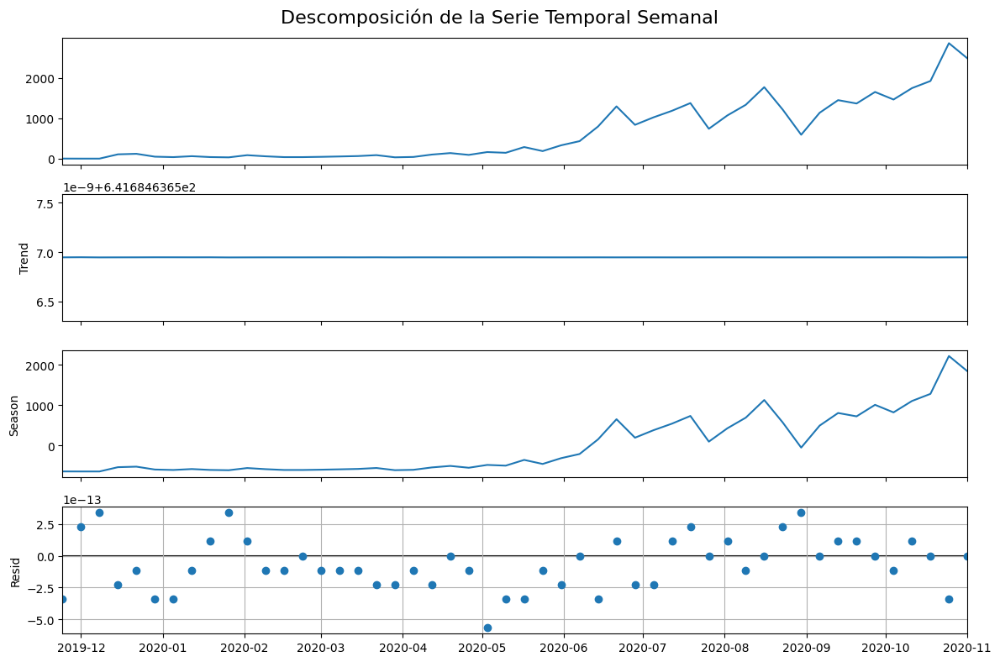

In [31]:
from statsmodels.tsa.seasonal import STL
df_s = df_jo.copy() # cr_cp

# Asegurarnos de que `created_at` esté en formato datetime
df_s['created_at'] = pd.to_datetime(df_s['created_at'])

# Agrupar los datos por semana, contando la cantidad de préstamos por semana
df_weekly_s = df_s.resample('W', on='created_at').size()

# Aplicar la descomposición STL (Seasonal and Trend decomposition using LOESS)
stl = STL(df_weekly_s, seasonal=13)  # Usamos 13 para capturar la estacionalidad semanal
result = stl.fit()

# Graficar la descomposición
fig = result.plot()
fig.set_size_inches((12, 8)) 
plt.grid()
plt.suptitle('Descomposición de la Serie Temporal Semanal', fontsize=16)
plt.tight_layout()
plt.show()


### Gráficos para Visualización de Datos

##### Volumen Total

##### Promedios por Mes

### Histogramas

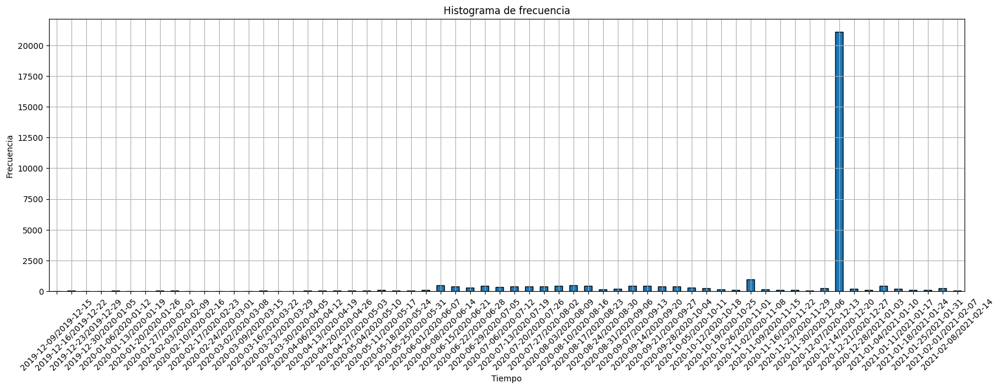

In [34]:
df = pm.df('df_jo')
m = df.groupby(pd.to_datetime(df['updated_at']).dt.to_period('W'))['id_cr'].count().plot(kind="bar",figsize=(20,6), edgecolor='black')
plt.xlabel('Tiempo')
plt.ylabel('Frecuencia')
plt.title('Histograma de frecuencia')
plt.xticks(rotation=45)
plt.grid()
plt.show()

/tmp/ipykernel_76307/940954342.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



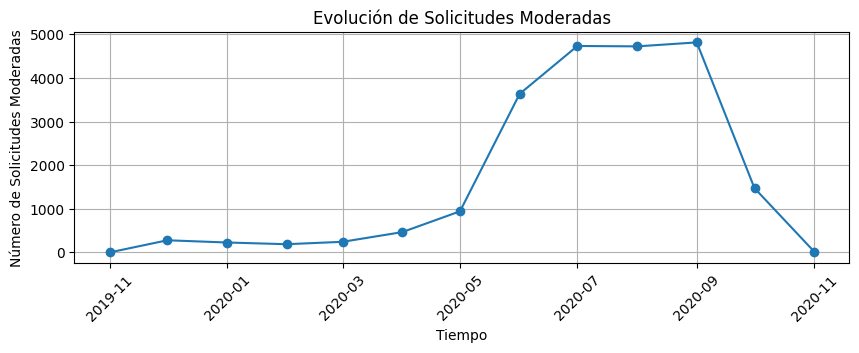

/tmp/ipykernel_76307/940954342.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



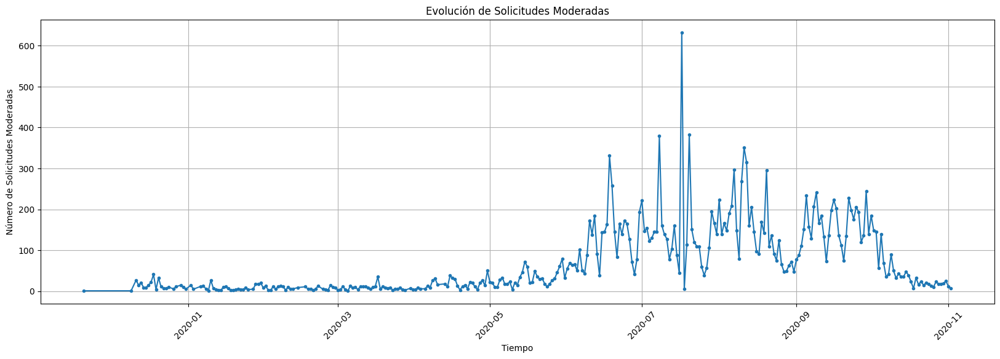

/tmp/ipykernel_76307/940954342.py:41: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



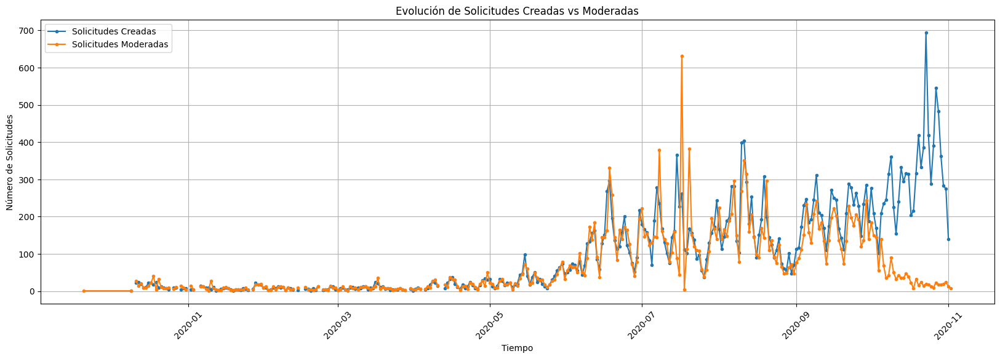

In [35]:
df_jo = pm.df('df_jall')
df = df_jo.copy().sort_values(['created_at','created_at_fe'])
#df.info()

# Dividir entre moderadas y no moderadas
moderated = df[df['moderated_at'].notnull()]
created_at = df[df['created_at'].notnull()]

# Agrupación por mes
moderated['moderated_at_m'] = moderated['moderated_at'].dt.to_period('M')  #M
#moderated['moderated_at_m'] = moderated['created_at'].dt.to_period('M')  #M

# Conteo de solicitudes moderadas por mes
moderation_time_series = moderated.groupby('moderated_at_m').size().reset_index(name='count')
# Conversión a datetime para graficar
moderation_time_series['moderated_at_m'] = moderation_time_series['moderated_at_m'].dt.to_timestamp()

plt.figure(figsize=(10, 3))
plt.plot(moderation_time_series['moderated_at_m'], moderation_time_series['count'], marker='o')
plt.title('Evolución de Solicitudes Moderadas')
plt.xlabel('Tiempo')
plt.ylabel('Número de Solicitudes Moderadas')
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

# Agrupación por dia
moderated['moderated_at_m'] = moderated['moderated_at'].dt.to_period('d')
moderation_time_series = moderated.groupby('moderated_at_m').size().reset_index(name='count')
moderation_time_series['moderated_at_m'] = moderation_time_series['moderated_at_m'].dt.to_timestamp()
plt.figure(figsize=(20, 6))
plt.plot(moderation_time_series['moderated_at_m'], moderation_time_series['count'], marker='.')
plt.title('Evolución de Solicitudes Moderadas')
plt.xlabel('Tiempo')
plt.ylabel('Número de Solicitudes Moderadas')
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

# Agrupación por dia
moderated['moderated_at_m'] = moderated['moderated_at'].dt.to_period('d')
created_at['created_at_m'] = created_at['created_at'].dt.to_period('d')

# Crear series de tiempo para las solicitudes moderadas y creadas
moderation_time_series = moderated.groupby('moderated_at_m').size().reset_index(name='count')
creation_time_series = created_at.groupby('created_at_m').size().reset_index(name='count')
#display(moderation_time_series.head(1))
#display(creation_time_series.head(1))

# Unir los dos dataframes para tener la fecha en ambos
merged_df = pd.merge(moderation_time_series, creation_time_series, left_on='moderated_at_m', right_on='created_at_m', how='outer')
#display(merged_df.head(1))
merged_df['moderated_at_m'] = merged_df['moderated_at_m'].dt.to_timestamp()
#display(merged_df.head(1))
# Crear un gráfico con dos líneas para mostrar la cantidad de solicitudes moderadas y creadas en cada día
plt.figure(figsize=(20, 6))
plt.plot(merged_df['moderated_at_m'], merged_df['count_y'], marker='.', label='Solicitudes Creadas')
plt.plot(merged_df['moderated_at_m'], merged_df['count_x'], marker='.', label='Solicitudes Moderadas')
plt.title('Evolución de Solicitudes Creadas vs Moderadas')
plt.xlabel('Tiempo')
plt.ylabel('Número de Solicitudes')
plt.grid(True)
plt.xticks(rotation=45)
plt.legend()
plt.show()

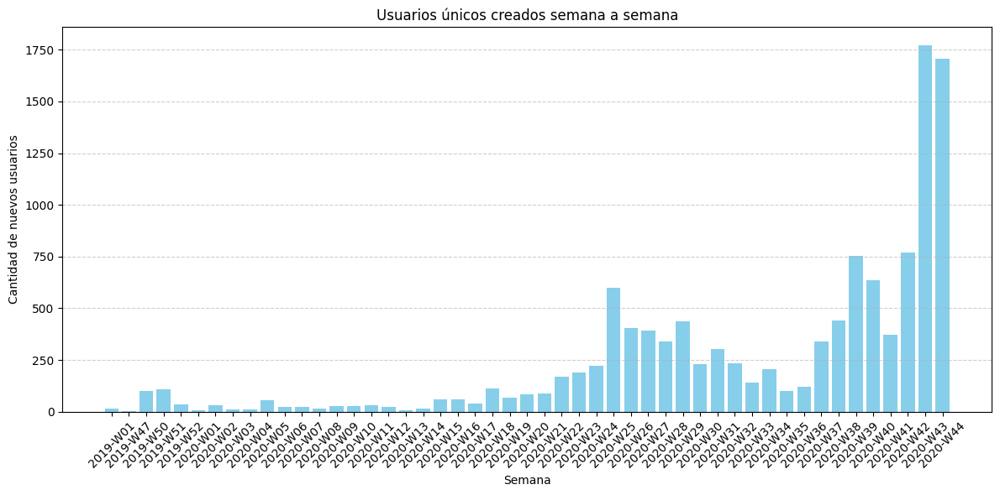

user_id
16391     37
15593     29
3045      28
23823     25
17144     25
          ..
103496     1
64005      1
103421     1
102737     1
897        1
Name: count, Length: 11938, dtype: int64


In [36]:
df = pm.df('df_jo')
# Crear columna de la semana del año
df['week'] = df['created_at'].dt.isocalendar().week
df['year'] = df['created_at'].dt.year

# Filtrar usuarios únicos por semana sin repetición previa
seen_users = set()
weekly_new_users = []

for week, group in df.groupby(['year', 'week']):
    # Filtrar los user_id únicos de la semana actual que no están en seen_users
    unique_users = group.loc[~group['user_id'].isin(seen_users), 'user_id'].unique()
    # Añadir los nuevos al conjunto acumulativo
    seen_users.update(unique_users)
    # Registrar el número de nuevos usuarios y la semana correspondiente
    weekly_new_users.append({'year_week': f"{week[0]}-W{week[1]:02d}", 'new_users': len(unique_users)})

# Convertir a DataFrame
weekly_data = pd.DataFrame(weekly_new_users)

# Graficar los resultados
plt.figure(figsize=(12, 6))
plt.bar(weekly_data['year_week'], weekly_data['new_users'], color='skyblue')
plt.xticks(rotation=45)
plt.title('Usuarios únicos creados semana a semana')
plt.xlabel('Semana')
plt.ylabel('Cantidad de nuevos usuarios')
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.6)

plt.show()
counts_user_id = df['user_id'].value_counts()
print(counts_user_id)

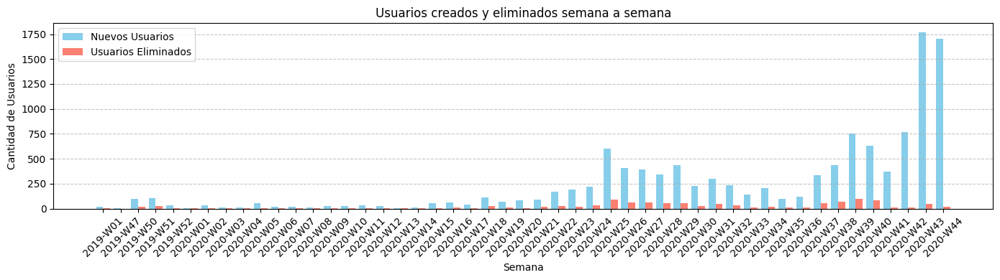

Total activos: 11938
Total eliminados: 1141


In [37]:
# Crear columna de la semana del año
df['week'] = df['created_at'].dt.isocalendar().week
df['year'] = df['created_at'].dt.year


# Filtrar usuarios únicos creados y eliminados semana a semana
seen_users_created = set()
seen_users_deleted = set()
weekly_user_stats = []

for week, group in df.groupby(['year', 'week']):
    # Nuevos usuarios creados
    unique_users_created = group.loc[~group['user_id'].isin(seen_users_created), 'user_id'].unique()
    seen_users_created.update(unique_users_created)

    # Usuarios eliminados (active == 0)
    unique_users_deleted = group.loc[
        (group['active'] == 0) & (~group['user_id'].isin(seen_users_deleted)), 'user_id'
    ].unique()
    seen_users_deleted.update(unique_users_deleted)

    # Registrar los datos
    weekly_user_stats.append({
        'year_week': f"{week[0]}-W{week[1]:02d}",
        'new_users': len(unique_users_created),
        'deleted_users': len(unique_users_deleted),
    })

# Convertir a DataFrame
weekly_data = pd.DataFrame(weekly_user_stats)

# Graficar los resultados con barras agrupadas
plt.figure(figsize=(14, 4))
bar_width = 0.4  # Ancho de las barras

# Posiciones de las barras en el eje X
x = range(len(weekly_data))

# Crear barras para nuevos usuarios
plt.bar([pos - bar_width / 2 for pos in x], weekly_data['new_users'], bar_width, label='Nuevos Usuarios', color='skyblue')

# Crear barras para usuarios eliminados
plt.bar([pos + bar_width / 2 for pos in x], weekly_data['deleted_users'], bar_width, label='Usuarios Eliminados', color='salmon')

# Personalización del gráfico
plt.title('Usuarios creados y eliminados semana a semana')
plt.xlabel('Semana')
plt.ylabel('Cantidad de Usuarios')
plt.xticks(x, weekly_data['year_week'], rotation=45)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Mostrar gráfico
plt.show()
print(f"Total activos: {len(seen_users_created)}")
print(f"Total eliminados: {len(seen_users_deleted)}")

### Estudio de registros

In [38]:
counts = cr_cp.status.value_counts()
display(counts)

counts = cr_cp.transfer_type.value_counts()
display(counts)

counts = cr_cp.recovery_status.value_counts()
display(counts)

counts = cr_cp.money_back_date.value_counts()
display(counts)

status
money_back               16395
rejected                  6568
direct_debit_rejected      831
active                      59
transaction_declined        48
direct_debit_sent           34
canceled                    33
Name: count, dtype: int64

transfer_type
instant    13882
regular    10086
Name: count, dtype: int64

recovery_status
nice                    20639
completed                2467
pending                   845
pending_direct_debit       16
cancelled                   1
Name: count, dtype: int64

money_back_date
2020-08-04 22:00:00.000000    364
2020-08-05 22:00:00.000000    295
2020-07-29 22:00:00.000000    244
2020-07-07 22:00:00.000000    180
2020-09-01 22:00:00.000000    134
                             ... 
2020-10-14 19:53:17.175800      1
2020-11-06 20:27:59.808825      1
2020-11-12 17:56:26.237355      1
2020-09-09 19:50:00.196742      1
2020-09-04 19:34:10.516739      1
Name: count, Length: 12265, dtype: int64

In [39]:
counts = fe_cp.status.value_counts()
display(counts)

counts = fe_cp.type.value_counts()
display(counts)

counts = fe_cp.category.value_counts()
display(counts)

counts = fe_cp.charge_moment.value_counts()
display(counts)

status
accepted     14841
cancelled     4934
rejected      1194
confirmed       88
Name: count, dtype: int64

type
instant_payment    11095
postpone            7766
incident            2196
Name: count, dtype: int64

category
nice                      18861
rejected_direct_debit      1599
month_delay_on_payment      597
Name: count, dtype: int64

charge_moment
after     16720
before     4337
Name: count, dtype: int64

In [40]:
pd.options.display.max_columns = None
good_cr = ['approved', 'money_sent', 'pending', 'direct_debit_sent', 'active', 'money_back']
good_fe = ['confirmed', 'accepted', 'cr_regular']
df_jo['needs_m_check2'] = (~((df_jo['stat_cr'].isin(good_cr)) & (df_jo['stat_fe'].isin(good_fe)))).astype(int)
fields.append('needs_m_check2')
display(df_jo[fields].head(5))
#display(df_jo.head(5))

,id_cr,user_id,created_at,moderated_at,to_reimbur,transfer_type,stat_cr,amount,fee,n_fees,n_backs,needs_m_check_recov,n_recovery,n_inc_back,n_inc_fees,n_cr_fe_w,n_cr_fe_m,stat_fe,id_fe,created_at_fe,updated_at_fe,reason,money_back_date,reimbursement_date,to_reimbur,from_date,to_date,charge_moment,type,recovery_status,created_at_slot,needs_m_check2
0,3,47,2019-11-19 13:57:53.511561,2019-11-20 12:16:50.000000,16 days 09:02:06.488439,regular,canceled,1.0,0.0,0,0,1,0,1,0,0,0,cr_regular,0,NaT,NaT,NaN,NaT,2019-12-05 23:00:00.000000,16 days 09:02:06.488439,NaT,NaT,NaN,0,nice,13,1
1,4,99001309,2019-12-09 14:47:35.190714,2019-12-09 14:58:28.000000,7 days 08:12:24.809286,regular,money_back,100.0,0.0,0,1,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2019-12-16 23:00:00,2019-12-16 23:00:00.000000,7 days 08:12:24.809286,NaT,NaT,NaN,0,nice,14,0
2,5,804,2019-12-10 19:05:21.596873,2019-12-11 16:47:42.405646,29 days 23:59:59.999490,regular,rejected,100.0,0.0,0,0,1,0,1,0,0,0,cr_regular,0,NaT,NaT,NaN,NaT,2020-01-09 19:05:21.596363,29 days 23:59:59.999490,NaT,NaT,NaN,0,nice,19,1
3,6,812,2019-12-10 19:05:48.921042,2019-12-11 09:40:33.000000,57 days 03:54:11.078958,regular,direct_debit_rejected,100.0,0.0,0,0,1,1,1,0,0,0,cr_regular,0,NaT,NaT,NaN,NaT,2020-02-05 23:00:00.000000,57 days 03:54:11.078958,NaT,NaT,NaN,0,pending,19,1
4,7,191,2019-12-10 19:13:35.825460,2019-12-11 09:46:59.777728,29 days 23:59:59.999581,regular,rejected,100.0,0.0,0,0,1,0,1,0,0,0,cr_regular,0,NaT,NaT,NaN,NaT,2020-01-09 19:13:35.825041,29 days 23:59:59.999581,NaT,NaT,NaN,0,nice,19,1


In [41]:
cohort_analysis_2 = (
    df_jo.query('stat_fe == "accepted" | stat_cr == "money_back"')
        .groupby(['user_id', 'Mes_created_at'], as_index=False)
        .agg(
            total_paid_fees=('fee', lambda x: x[df_jo.loc[x.index, 'stat_fe'] == 'accepted'].sum()),            
            # Contar los valores únicos de 'stat_cr' donde su valor sea 'money_back'
            total_paid_cr=('amount', lambda x: x[df_jo.loc[x.index, 'stat_cr'] == 'money_back'].unique().sum()),
            # Contar los valores únicos de 'id_cr' donde 'stat_cr' es igual a 'money_back'
            Num_Solicitudes=('id_cr', lambda x: x[df_jo.loc[x.index, 'stat_cr'] == 'money_back'].nunique())
        )
)

In [42]:
# Restablecer el índice para un DataFrame limpio (opcional, ya garantizado por as_index=False)
cohort_analysis_2.reset_index(drop=True, inplace=True)

# Calcular el índice como porcentaje entre 'total_paid_fees' y 'total_paid_cr'
cohort_analysis_2['cash_index'] = (
    cohort_analysis_2['total_paid_fees'] / cohort_analysis_2['total_paid_cr'] ) * 100

# Reemplazar valores 'inf' con 0 para manejar divisiones por cero
cohort_analysis_2['cash_index'] = cohort_analysis_2['cash_index'].replace(np.inf, 0)

# Calcular la fecha del último pedido por usuario a partir del DataFrame original
df_jo['created_at'] = pd.to_datetime(df_jo['created_at'])  # Asegurarse de que el formato sea datetime
last_order_per_user = (
    df_jo.groupby('user_id')['created_at']
    .max()  # Obtener la fecha más reciente de pedido para cada usuario
    .dt.to_period('M')  # Convertir a periodo mensual
    .reset_index()  # Restablecer el índice para facilitar el merge
)

# Incorporar la fecha del último pedido en el DataFrame de análisis de cohortes
cohort_analysis_2 = pd.merge(
    cohort_analysis_2,
    last_order_per_user.rename(columns={'created_at': 'last_order'}),
    on='user_id',
    how='left'
)

display(cohort_analysis_2.head(5))

,user_id,Mes_created_at,total_paid_fees,total_paid_cr,Num_Solicitudes,cash_index,last_order
0,47,2020-04,0.0,100.0,1,0.000000,2020-10
1,47,2020-05,5.0,10.0,1,50.000000,2020-10
2,47,2020-08,10.0,10.0,1,100.000000,2020-10
3,47,2020-09,5.0,5.0,1,100.000000,2020-10
4,47,2020-10,10.0,6.0,2,166.666667,2020-10


### Estudio de casos de clientes concretos (user_id)

* 102105
* 16391 
* 2002
* 13851
* 1987 
* ...
* 16391 # 2002, 1987, 13851, 16391, 102105

* user_ids = [13851] [2002] , 1987, 1946, 90, 526, 12934] #, 12274 54879 12441, 13851, 16391, 430,  63894,18730,10116,21465, 99000262]
* vips 12934 526
* 90 Este se esta gestionando mal: todos instant, con demoras y sin gestion por 
* 1946 Parece un ejemplo de buena gestion, al final tiene un instant y se le ha dado margen el las demoras.
* 1987 Parece un ejemplo de buen usuario, se pasa a instant para siempre.

Casos que esta examinando Alba:
* 19655
* 21465
* 14631


In [43]:
display(cohort_analysis_2[cohort_analysis_2.user_id == 102105])

display(cohort_analysis_2[cohort_analysis_2.user_id == 16391])
display(cohort_analysis_2[cohort_analysis_2.user_id == 2002])
display(cohort_analysis_2[cohort_analysis_2.user_id == 13851])
display(cohort_analysis_2[cohort_analysis_2.user_id == 1987]) #.tail(60))

,user_id,Mes_created_at,total_paid_fees,total_paid_cr,Num_Solicitudes,cash_index,last_order
15482,102105,2020-10,0.0,100.0,1,0.0,2020-10


,user_id,Mes_created_at,total_paid_fees,total_paid_cr,Num_Solicitudes,cash_index,last_order
5421,16391,2020-06,5.0,100.0,1,5.0,2020-10
5422,16391,2020-08,10.0,100.0,1,10.0,2020-10
5423,16391,2020-10,5.0,100.0,1,5.0,2020-10


,user_id,Mes_created_at,total_paid_fees,total_paid_cr,Num_Solicitudes,cash_index,last_order
747,2002,2020-01,0.0,100.0,1,0.0,2020-10
748,2002,2020-02,0.0,100.0,1,0.0,2020-10
749,2002,2020-03,0.0,100.0,1,0.0,2020-10
750,2002,2020-04,0.0,100.0,1,0.0,2020-10
751,2002,2020-05,0.0,100.0,1,0.0,2020-10
752,2002,2020-06,0.0,100.0,1,0.0,2020-10
753,2002,2020-07,15.0,100.0,1,15.0,2020-10
754,2002,2020-08,0.0,100.0,1,0.0,2020-10
755,2002,2020-09,0.0,100.0,1,0.0,2020-10
756,2002,2020-10,5.0,100.0,1,5.0,2020-10


,user_id,Mes_created_at,total_paid_fees,total_paid_cr,Num_Solicitudes,cash_index,last_order
4640,13851,2020-08,5.0,150.0,2,3.333333,2020-10
4641,13851,2020-10,5.0,100.0,1,5.000000,2020-10


,user_id,Mes_created_at,total_paid_fees,total_paid_cr,Num_Solicitudes,cash_index,last_order
733,1987,2019-12,0.0,100.0,1,0.0,2020-10
734,1987,2020-01,0.0,100.0,1,0.0,2020-10
735,1987,2020-02,0.0,100.0,1,0.0,2020-10
736,1987,2020-03,0.0,100.0,1,0.0,2020-10
737,1987,2020-04,0.0,100.0,1,0.0,2020-10
738,1987,2020-05,0.0,100.0,1,0.0,2020-10
739,1987,2020-06,10.0,100.0,1,10.0,2020-10
740,1987,2020-08,15.0,100.0,1,15.0,2020-10
741,1987,2020-10,10.0,100.0,2,10.0,2020-10


In [44]:
user_id = 2002# 16391 # 2002, 1987, 13851, 16391, 102105
display(cohort_analysis_2[cohort_analysis_2.user_id == user_id])

#print("Casos segun Cash Request ID")
pd.options.display.max_columns = None
for id in ([-8177]): # 16391 20108, 20104, 20112,
    df_t = df_jo[df_jo['id_cr'] == id].sort_values(['created_at','created_at_fe']).reset_index()
    print(f"Cash Request ID: {id}")
    display(df_t[fields])

user_ids = [user_id] 
pd.options.display.max_columns = None
#print("Casos segun Cash User ID")
for id in (user_ids):
    df_t = df_jo[(df_jo['user_id'] == id)]#.reset_index()
    df_t = df_t[df_t['stat_cr'] == 'money_back']
    df_t = df_t[df_t['stat_fe'] == 'accepted']
    
    df_t = df_t.sort_values(['created_at','created_at_fe']).reset_index(drop=True)
    #df_t.set_index('id_cr', inplace=True)
    print(f"Only money_back - user_id {id}")
    display(df_t[fields])
    df_t = df_jo[(df_jo['user_id'] == id) ].sort_values(['created_at','created_at_fe']).reset_index(drop=True)

    print(f"user_id {id}")
    display(df_t[fields])

,user_id,Mes_created_at,total_paid_fees,total_paid_cr,Num_Solicitudes,cash_index,last_order
747,2002,2020-01,0.0,100.0,1,0.0,2020-10
748,2002,2020-02,0.0,100.0,1,0.0,2020-10
749,2002,2020-03,0.0,100.0,1,0.0,2020-10
750,2002,2020-04,0.0,100.0,1,0.0,2020-10
751,2002,2020-05,0.0,100.0,1,0.0,2020-10
752,2002,2020-06,0.0,100.0,1,0.0,2020-10
753,2002,2020-07,15.0,100.0,1,15.0,2020-10
754,2002,2020-08,0.0,100.0,1,0.0,2020-10
755,2002,2020-09,0.0,100.0,1,0.0,2020-10
756,2002,2020-10,5.0,100.0,1,5.0,2020-10


Cash Request ID: -8177


,id_cr,user_id,created_at,moderated_at,to_reimbur,transfer_type,stat_cr,amount,fee,n_fees,n_backs,needs_m_check_recov,n_recovery,n_inc_back,n_inc_fees,n_cr_fe_w,n_cr_fe_m,stat_fe,id_fe,created_at_fe,updated_at_fe,reason,money_back_date,reimbursement_date,to_reimbur,from_date,to_date,charge_moment,type,recovery_status,created_at_slot,needs_m_check2


Only money_back - user_id 2002


,id_cr,user_id,created_at,moderated_at,to_reimbur,transfer_type,stat_cr,amount,fee,n_fees,n_backs,needs_m_check_recov,n_recovery,n_inc_back,n_inc_fees,n_cr_fe_w,n_cr_fe_m,stat_fe,id_fe,created_at_fe,updated_at_fe,reason,money_back_date,reimbursement_date,to_reimbur,from_date,to_date,charge_moment,type,recovery_status,created_at_slot,needs_m_check2
0,8177,2002,2020-07-15 13:17:11.174285,2020-07-17 08:40:18,20 days 12:16:36.825715,regular,money_back,100.0,5.0,1,7,0,0,0,1,3,3,accepted,1749,2020-07-22 01:33:56.400884,2020-10-13 14:25:00.882490,Postpone Cash Request 8177,2020-08-03 09:01:41.363548,2020-08-05 01:33:48,20 days 12:16:36.825715,2020-08-04 22:00:00.000,2020-08-15 01:33:48.128,before,postpone,nice,13,0
1,8177,2002,2020-07-15 13:17:11.174285,2020-07-17 08:40:18,20 days 12:16:36.825715,regular,money_back,100.0,5.0,2,7,0,0,0,1,3,3,accepted,1839,2020-07-23 11:31:44.836318,2020-10-13 14:25:02.005106,Postpone Cash Request 8177,2020-08-03 09:01:41.363548,2020-08-05 01:33:48,20 days 12:16:36.825715,2020-08-15 01:33:48.128,2020-08-30 01:33:48.128,before,postpone,nice,13,0
2,8177,2002,2020-07-15 13:17:11.174285,2020-07-17 08:40:18,20 days 12:16:36.825715,regular,money_back,100.0,5.0,3,7,0,0,0,1,3,3,accepted,1977,2020-07-25 19:20:00.560197,2020-10-13 14:25:04.227093,Postpone Cash Request 8177,2020-08-03 09:01:41.363548,2020-08-05 01:33:48,20 days 12:16:36.825715,2020-08-30 01:33:48.128,2020-09-14 01:33:48.128,before,postpone,nice,13,0
3,24248,2002,2020-10-25 07:41:00.266568,NaT,15 days 14:18:59.733432,instant,money_back,100.0,5.0,4,10,0,0,0,1,1,1,accepted,17289,2020-10-25 07:41:49.198215,2020-10-25 07:41:49.198245,Instant Payment Cash Request 24248,2020-11-09 19:11:48.425712,2020-11-09 22:00:00,15 days 14:18:59.733432,NaT,NaT,after,instant_payment,nice,7,0


user_id 2002


,id_cr,user_id,created_at,moderated_at,to_reimbur,transfer_type,stat_cr,amount,fee,n_fees,n_backs,needs_m_check_recov,n_recovery,n_inc_back,n_inc_fees,n_cr_fe_w,n_cr_fe_m,stat_fe,id_fe,created_at_fe,updated_at_fe,reason,money_back_date,reimbursement_date,to_reimbur,from_date,to_date,charge_moment,type,recovery_status,created_at_slot,needs_m_check2
0,423,2002,2020-01-10 10:55:20.757139,2020-01-10 14:07:53.226098,27 days 12:04:39.242861,regular,money_back,100.0,0.0,0,1,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-02-06 23:00:00.000000,2020-02-06 23:00:00,27 days 12:04:39.242861,NaT,NaT,NaN,0,nice,10,0
1,697,2002,2020-02-18 16:36:51.249037,2020-02-19 10:52:06.054881,9 days 06:23:08.750963,regular,money_back,100.0,0.0,0,2,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-02-27 23:00:00.000000,2020-02-27 23:00:00,9 days 06:23:08.750963,NaT,NaT,NaN,0,nice,16,0
2,835,2002,2020-03-10 07:47:39.337041,2020-03-10 09:29:45.938994,26 days 14:12:20.662959,regular,money_back,100.0,0.0,0,3,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-04-14 20:25:59.132327,2020-04-05 22:00:00,26 days 14:12:20.662959,NaT,NaT,NaN,0,nice,7,0
3,1172,2002,2020-04-14 21:03:09.519326,2020-04-15 09:33:29.732785,21 days 00:56:50.480674,regular,money_back,100.0,0.0,0,4,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-05-14 21:05:09.488707,2020-05-05 22:00:00,21 days 00:56:50.480674,NaT,NaT,NaN,0,nice,21,0
4,1800,2002,2020-05-15 04:09:51.091889,2020-05-15 09:08:21.143739,22 days 17:50:08.908111,regular,money_back,100.0,0.0,0,5,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-06-10 22:17:53.131912,2020-06-06 22:00:00,22 days 17:50:08.908111,NaT,NaT,NaN,0,nice,4,0
5,2949,2002,2020-06-10 23:34:13.556501,2020-06-11 10:26:29.126647,25 days 22:25:46.443499,regular,money_back,100.0,0.0,0,6,0,0,0,0,1,1,cr_regular,0,NaT,NaT,NaN,2020-07-07 22:00:00.000000,2020-07-06 22:00:00,25 days 22:25:46.443499,NaT,NaT,NaN,0,nice,23,0
6,8177,2002,2020-07-15 13:17:11.174285,2020-07-17 08:40:18.000000,20 days 12:16:36.825715,regular,money_back,100.0,5.0,0,7,1,0,0,1,3,3,cancelled,1674,2020-07-20 20:43:33.629841,2020-10-13 14:25:15.265408,Postpone Cash Request 8177,2020-08-03 09:01:41.363548,2020-08-05 01:33:48,20 days 12:16:36.825715,2020-08-04 22:00:00.000,2020-08-19 22:00:00.000,after,postpone,nice,13,1
7,8177,2002,2020-07-15 13:17:11.174285,2020-07-17 08:40:18.000000,20 days 12:16:36.825715,regular,money_back,100.0,5.0,1,7,0,0,0,1,3,3,accepted,1749,2020-07-22 01:33:56.400884,2020-10-13 14:25:00.882490,Postpone Cash Request 8177,2020-08-03 09:01:41.363548,2020-08-05 01:33:48,20 days 12:16:36.825715,2020-08-04 22:00:00.000,2020-08-15 01:33:48.128,before,postpone,nice,13,0
8,8177,2002,2020-07-15 13:17:11.174285,2020-07-17 08:40:18.000000,20 days 12:16:36.825715,regular,money_back,100.0,5.0,2,7,0,0,0,1,3,3,accepted,1839,2020-07-23 11:31:44.836318,2020-10-13 14:25:02.005106,Postpone Cash Request 8177,2020-08-03 09:01:41.363548,2020-08-05 01:33:48,20 days 12:16:36.825715,2020-08-15 01:33:48.128,2020-08-30 01:33:48.128,before,postpone,nice,13,0
9,8177,2002,2020-07-15 13:17:11.174285,2020-07-17 08:40:18.000000,20 days 12:16:36.825715,regular,money_back,100.0,5.0,3,7,0,0,0,1,3,3,accepted,1977,2020-07-25 19:20:00.560197,2020-10-13 14:25:04.227093,Postpone Cash Request 8177,2020-08-03 09:01:41.363548,2020-08-05 01:33:48,20 days 12:16:36.825715,2020-08-30 01:33:48.128,2020-09-14 01:33:48.128,before,postpone,nice,13,0


### Estudio de top FEES

In [45]:
pd.options.display.max_rows = None
tops = df_jo[df_jo['stat_cr' ]== 'money_back'].groupby('user_id').agg(fees=('fee','sum'))
tops = df_jo[df_jo['stat_fe'] == 'accepted'  ].groupby('user_id').agg(fees=('fee','sum'))
#display(df_jo[tops])
top_users = tops.sort_values(by='fees', ascending=False).iloc[:10].reset_index()
display(top_users)
#top_users = tops.sort_values(by='fees', ascending=True).iloc[:10]
#display(top_users)

#display(df_jo[top_users])

,user_id,fees
0,17144,75.0
1,12934,55.0
2,13404,35.0
3,6219,35.0
4,17603,35.0
5,8944,35.0
6,99021532,35.0
7,1987,35.0
8,9199,35.0
9,23164,35.0


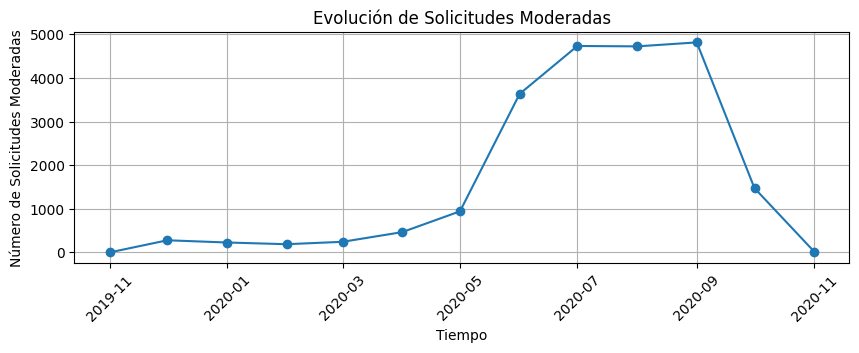

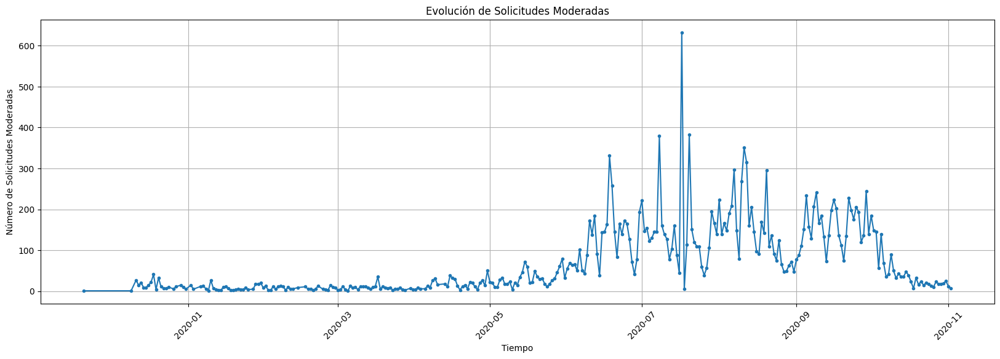

In [46]:
#df.info()
#df['moderated_at'] = pd.to_datetime(df['moderated_at'])
#df['created_at'] = pd.to_datetime(df['created_at'])  # Por si se usa como referencia

# Agrupación por mes
moderated['moderated_at_m'] = moderated['moderated_at'].dt.to_period('M')  #M
#moderated['moderated_at_m'] = moderated['created_at'].dt.to_period('M')  #M

# Conteo de solicitudes moderadas por mes
moderation_time_series = moderated.groupby('moderated_at_m').size().reset_index(name='count')
# Conversión a datetime para graficar
moderation_time_series['moderated_at_m'] = moderation_time_series['moderated_at_m'].dt.to_timestamp()

plt.figure(figsize=(10, 3))
plt.plot(moderation_time_series['moderated_at_m'], moderation_time_series['count'], marker='o')
plt.title('Evolución de Solicitudes Moderadas')
plt.xlabel('Tiempo')
plt.ylabel('Número de Solicitudes Moderadas')
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

# Agrupación por dia
moderated['moderated_at_m'] = moderated['moderated_at'].dt.to_period('d')
moderation_time_series = moderated.groupby('moderated_at_m').size().reset_index(name='count')
moderation_time_series['moderated_at_m'] = moderation_time_series['moderated_at_m'].dt.to_timestamp()
plt.figure(figsize=(20, 6))
plt.plot(moderation_time_series['moderated_at_m'], moderation_time_series['count'], marker='.')
plt.title('Evolución de Solicitudes Moderadas')
plt.xlabel('Tiempo')
plt.ylabel('Número de Solicitudes Moderadas')
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

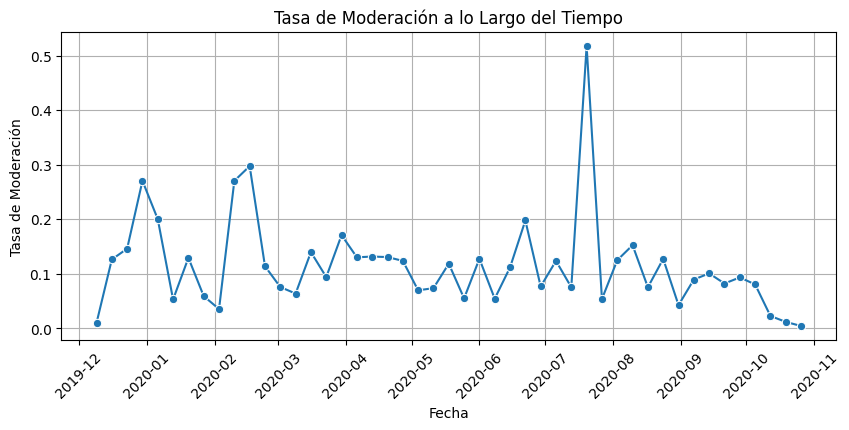

In [47]:
df_t = df.copy()
# # Agrupación por mes
# moderated['moderated_at_m'] = moderated['moderated_at'].dt.to_period('M')  #M
# #moderated['moderated_at_m'] = moderated['created_at'].dt.to_period('M')  #M

# Agrupación por dia
moderated['moderated_at_m'] = moderated['moderated_at'].dt.to_period('d')
moderation_time_series = moderated.groupby('moderated_at_m').size().reset_index(name='count')
moderation_time_series['moderated_at_m'] = moderation_time_series['moderated_at_m'].dt.to_timestamp()


# Total de solicitudes por mes
df_t['moderated_at_m'] = df_t['created_at'].dt.to_period('W')
total_requests = df_t.groupby('moderated_at_m').size().reset_index(name='total_count')
total_requests['moderated_at_m'] = total_requests['moderated_at_m'].dt.to_timestamp()

# Unir con los datos de solicitudes moderadas
moderation_time_series = moderation_time_series.merge(total_requests, on='moderated_at_m')
moderation_time_series['moderation_rate'] = moderation_time_series['count'] / moderation_time_series['total_count']

plt.figure(figsize=(10, 4))
sns.lineplot(data=moderation_time_series, x='moderated_at_m', y='moderation_rate', marker='o')
plt.title('Tasa de Moderación a lo Largo del Tiempo')
plt.xlabel('Fecha')
plt.ylabel('Tasa de Moderación')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

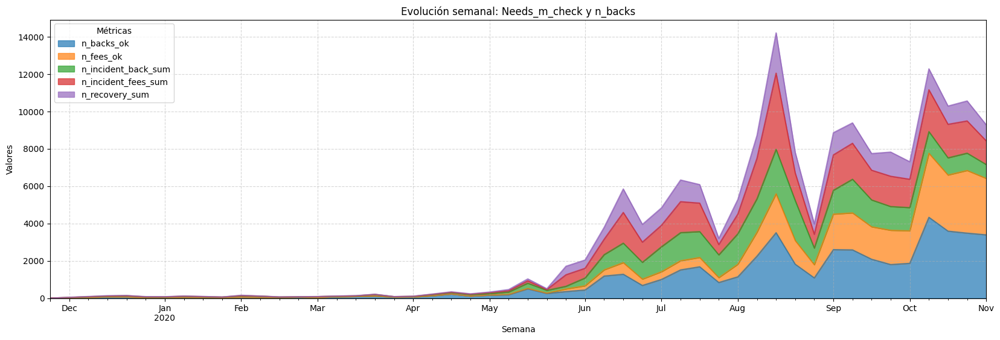

In [48]:
# Agrupar por semana y calcular las métricas
df['week'] = df['created_at'].dt.to_period('W')
grupo = df.groupby('week').agg(
    #needs_m_check_sum=('needs_m_check_recov', 'sum'),
    #n_backs_sum=('n_recovery', 'sum')
    n_backs_ok=('n_backs', 'sum'),
    n_fees_ok=('n_fees', 'sum'),
    n_incident_back_sum=('n_inc_back', 'sum'),
    n_incident_fees_sum=('n_inc_fees', 'sum'),
    n_recovery_sum=('n_recovery', 'sum'),
)

# Crear gráfico de áreas apiladas
fig, ax = plt.subplots(figsize=(20, 6))
grupo.plot.area(ax=ax, alpha=0.7)

# Configurar etiquetas, título y rejilla
plt.title("Evolución semanal: Needs_m_check y n_backs")
plt.xlabel("Semana")
plt.ylabel("Valores")
plt.legend(title="Métricas")
plt.grid(alpha=0.5, linestyle='--')
plt.show()


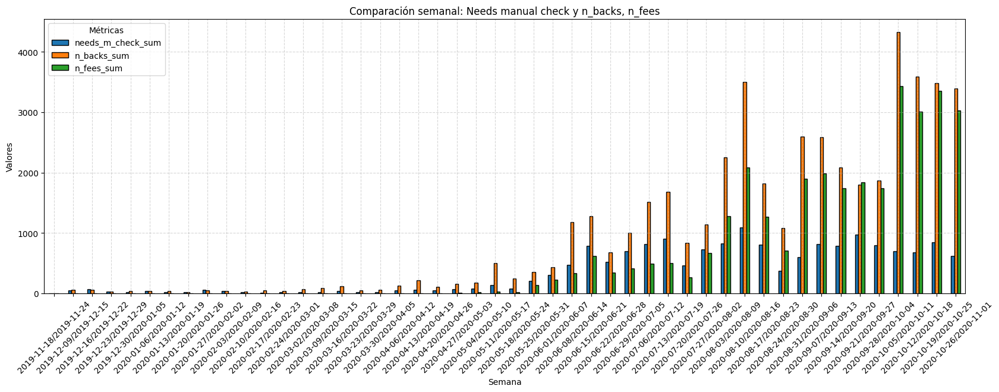

In [49]:
df_t = df.copy()

# Agrupar por semana y calcular las métricas
df_t['week'] = df_t['created_at'].dt.to_period('W')
grupo = df_t.groupby('week').agg(
    needs_m_check_sum=('needs_m_check_recov', 'sum'),
    n_backs_sum=('n_backs', 'sum'),
    n_fees_sum=('n_fees', 'sum')
)

# Crear gráfico de barras agrupadas
fig, ax = plt.subplots(figsize=(20, 6))
grupo.plot(kind='bar', ax=ax, edgecolor='black')

# Configurar etiquetas, título y rejilla
plt.title("Comparación semanal: Needs manual check y n_backs, n_fees")
plt.xlabel("Semana")
plt.ylabel("Valores")
plt.legend(title="Métricas")
plt.xticks(rotation=45)
plt.grid(alpha=0.5, linestyle='--')
plt.show()

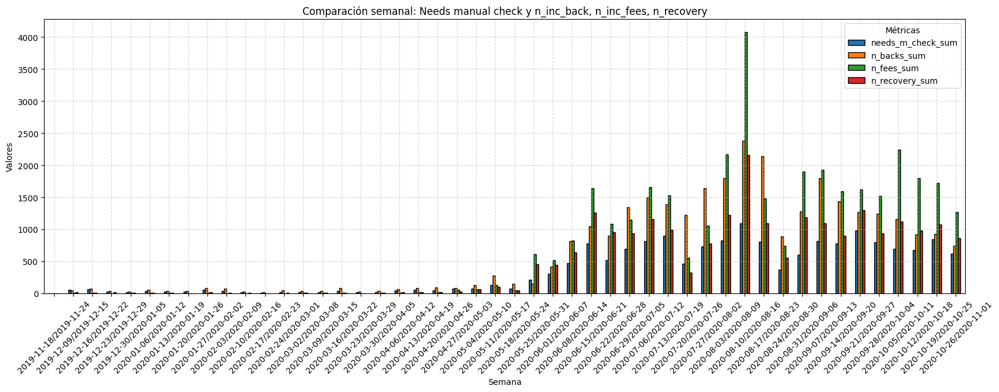

In [50]:
# Aqui claramente, estan filtrada las que se han completado correctamente.
# Agrupar por semana y calcular las métricas
df_t['week'] = df_t['created_at'].dt.to_period('W')
grupo = df_t.groupby('week').agg(
    needs_m_check_sum=('needs_m_check_recov', 'sum'),
    n_backs_sum=('n_inc_back', 'sum'),
    n_fees_sum=('n_inc_fees', 'sum'),
    n_recovery_sum= ('n_recovery', 'sum'),
)

# Crear gráfico de barras agrupadas
fig, ax = plt.subplots(figsize=(20, 6))
grupo.plot(kind='bar', ax=ax, edgecolor='black')

# Configurar etiquetas, título y rejilla
plt.title("Comparación semanal: Needs manual check y n_inc_back, n_inc_fees, n_recovery")
plt.xlabel("Semana")
plt.ylabel("Valores")
plt.legend(title="Métricas")
plt.xticks(rotation=45)
plt.grid(alpha=0.5, linestyle='--')
plt.show()

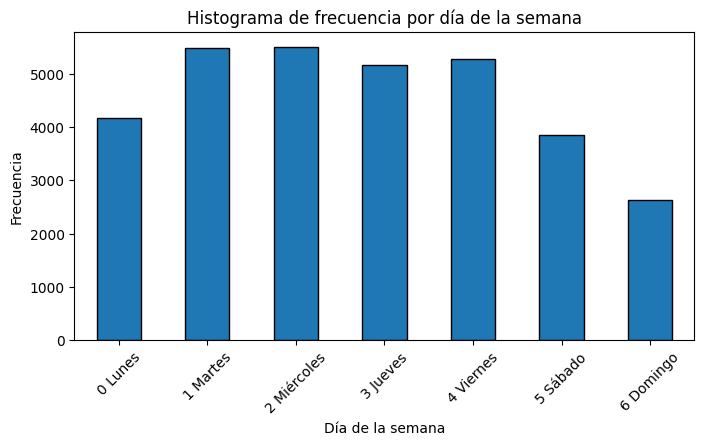

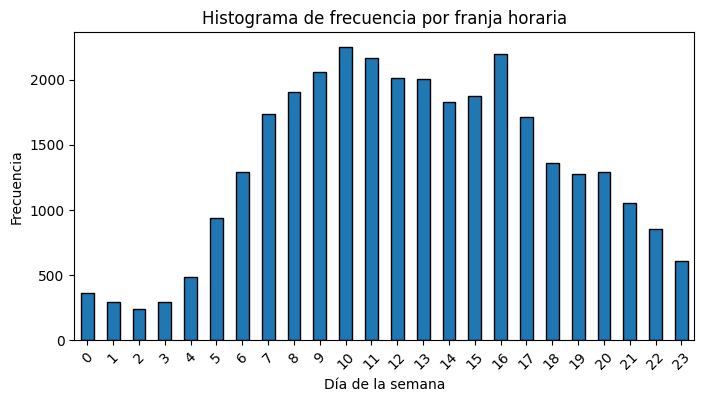

In [52]:
df_t = pm.df('df_jo')
#df['Mes_created_at_d'] = df_t['created_at'].dt.to_period('d').astype(str)
#display(df.head(5))

# Define el diccionario de mapeo del día de la semana
dia_semana = {
    0: '0 Lunes',
    1: '1 Martes',
    2: '2 Miércoles',
    3: '3 Jueves',
    4: '4 Viernes',
    5: '5 Sábado',
    6: '6 Domingo'
}
df_t['created_at_dow_n'] = (df_t['created_at_dow']).map(dia_semana)
m = df_t.groupby(df_t.created_at_dow_n,sort=True)['id_cr'].count().plot(kind="bar",figsize=(8,4), edgecolor='black')
plt.xlabel('Día de la semana')
plt.ylabel('Frecuencia')
plt.title('Histograma de frecuencia por día de la semana')
plt.xticks(rotation=45)
plt.show()

m = df_t.groupby(pd.to_datetime(df_t['created_at']).dt.hour)['id_cr'].count().plot(kind="bar",figsize=(8,4), edgecolor='black')
plt.xlabel('Día de la semana')
plt.ylabel('Frecuencia')
plt.title('Histograma de frecuencia por franja horaria')
plt.xticks(rotation=45)
plt.show()

# m = df_t.groupby(df.created_at_slot,sort=False)['id_cr'].count().plot(kind="bar",figsize=(8,4), edgecolor='black')
# plt.xlabel('Día de la semana')
# plt.ylabel('Frecuencia')
# plt.title('Histograma de frecuencia por tramo horario')
# plt.xticks(rotation=45)
# plt.show()

### Plazos de los prestamos

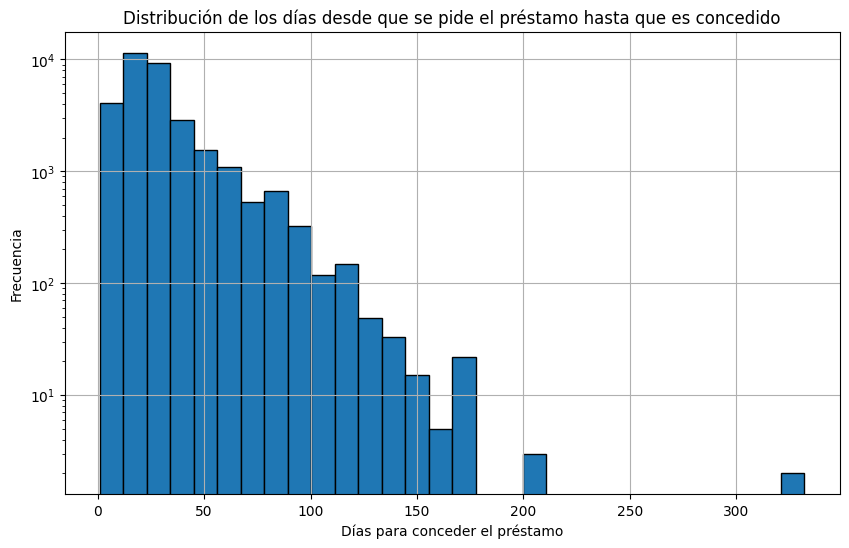

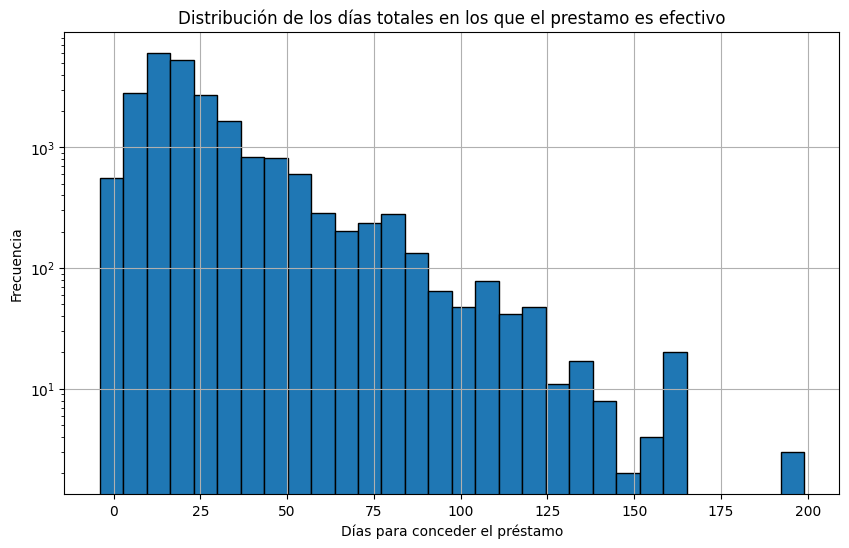

In [53]:
import pandas as pd
import matplotlib.pyplot as plt

# Asegúrate de que las columnas de fecha estén en formato datetime
df_jo['created_at'] = pd.to_datetime(df_jo['created_at'])
df_jo['reimbursement_date'] = pd.to_datetime(df_jo['reimbursement_date'])

# Calcular los días transcurridos entre la creación y el reembolso
df_jo['days_to_concede'] = (df_jo['reimbursement_date'] - df_jo['created_at']).dt.days

# Graficar la distribución de los días
plt.figure(figsize=(10, 6))
plt.hist(df_jo['days_to_concede'], bins=30, edgecolor='black')
plt.title('Distribución de los días desde que se pide el préstamo hasta que es concedido')
plt.xlabel('Días para conceder el préstamo')
plt.ylabel('Frecuencia')
plt.yscale('log')
plt.grid(True)
plt.show()

# Tiempo en el que la emprera realmente ha prestado el dinero
#df_jo['to_reimbur_cash'] = df_jo.reimbursement_date-df_jo.send_at
# Graficar la distribución de los días
plt.figure(figsize=(10, 6))
#plt.hist(df_jo['days_to_concede'], bins=30, edgecolor='black')
plt.hist(df_jo['to_reimbur_cash'].dt.days, bins=30, edgecolor='black')
plt.title('Distribución de los días totales en los que el prestamo es efectivo')
plt.xlabel('Días para conceder el préstamo')
plt.ylabel('Frecuencia')
plt.yscale('log')
plt.grid(True)
plt.show()

Outliers encontrados:


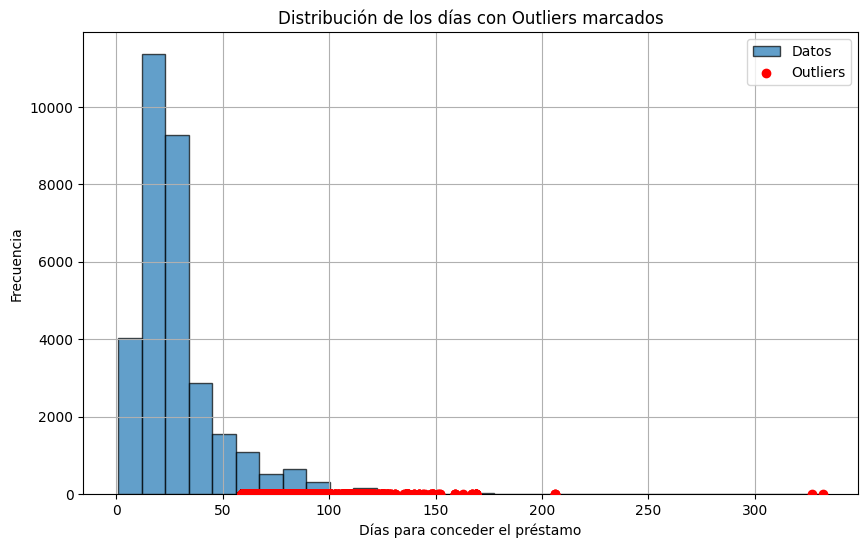

In [55]:
import numpy as np

# Calcular estadísticas descriptivas
q1 = np.percentile(df_jo['days_to_concede'], 25)  # Percentil 25
q3 = np.percentile(df_jo['days_to_concede'], 75)  # Percentil 75
iqr = q3 - q1  # Rango intercuartil

# Limites para detectar outliers
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr

# Identificar los outliers
outliers = df_jo[(df_jo['days_to_concede'] < lower_bound) | (df_jo['days_to_concede'] > upper_bound)]
print("Outliers encontrados:")
#print(outliers)

plt.figure(figsize=(10, 6))

# Histograma principal
plt.hist(df_jo['days_to_concede'], bins=30, edgecolor='black', alpha=0.7, label='Datos')

# Superponer los outliers
plt.scatter(outliers['days_to_concede'], np.zeros_like(outliers['days_to_concede']), 
            color='red', label='Outliers', zorder=5)

# Configuración del gráfico
plt.title('Distribución de los días con Outliers marcados')
plt.xlabel('Días para conceder el préstamo')
plt.ylabel('Frecuencia')
plt.legend()
plt.grid(True)
plt.show()



TODO

* Exogenos
* Explicar columnas calculadas
* Outlayers

